In [852]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import ndimage
from brian2 import *
from skimage import data
import math
import cv2
from PIL import Image
import torch.nn.functional as F


# Function to apply filter and show results
def apply_and_show_filter(image, filter_func, title):
    filtered = ndimage.convolve(image, filter_func, mode='constant', cval=0.0)
    plt.figure(figsize=(12, 4))
    plt.subplot(131), plt.imshow(image, cmap='gray'), plt.title('Original Image')
    plt.subplot(132), plt.imshow(filter_func, cmap='gray'), plt.title('Filter')
    plt.subplot(133), plt.imshow(filtered, cmap='gray'), plt.title(title)
    plt.show()
    return filtered


### DoG

tensor(0.0017) tensor(-2.9048e-05)
tensor(2.9048e-05) tensor(-0.0017)


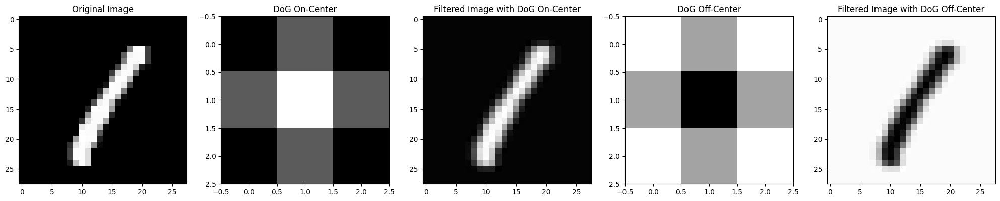

In [909]:

import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# IMAGES = ['mandrill.tif']
# path = '/Users/macbook/Desktop/CNS/Projects/P05/img'
# x_train = np.array([np.array(Image.open(f'{path}/{img}').convert('L').resize((225, 225))) for img in IMAGES])

(X_train, _), (_, _) = tf.keras.datasets.mnist.load_data()
x_train = np.array([resize(img, (28, 28), anti_aliasing=True) for img in X_train[:10]])
Xx = torch.tensor(x_train, dtype=torch.float32)
Xx = Xx / 255.0
image = Xx[3].unsqueeze(0).unsqueeze(0)

# x_train = np.array([
#     rgb2gray(resize(img, (112, 112), anti_aliasing=True))
#     for img in X_train[:50]
# ])
# Select a random digit image
# random_index = np.random.randint(0, len(x_train))
# image = x_train[random_index]
# print(image.shape)
# image_upscaled = image / 255.0
# plt.imshow(image_upscaled, cmap='gray')
# Xx = torch.tensor(image_upscaled, dtype=torch.float32).unsqueeze(0).unsqueeze(0)
size = 3  # Increased size for larger images
sigma1 = 1
sigma2 = 2

# dog_on, dog_off = dog_filter(size, sigma1, sigma2)
# filtered_on = apply_filter(image_upscaled, dog_off)
# filtered_off = apply_filter(image_upscaled, dog_on)

dog_on = DoGFilter(size=size, sigma_1=sigma1, sigma_2=sigma2, dtype=torch.float32).clone().detach()
dog_off = DoGFilter(size=size, sigma_1=sigma2, sigma_2=sigma1, dtype=torch.float32).clone().detach()
convFilter_on = Conv2dFilter(filters=dog_on.unsqueeze(0).unsqueeze(0), padding='same')
convolved_on = convFilter_on(image).squeeze(0).squeeze(0)
print(convolved_on.max(), convolved_on.min())
convFilter_off = Conv2dFilter(filters=dog_off.unsqueeze(0).unsqueeze(0), padding='same')
convolved_off = convFilter_off(image).squeeze(0).squeeze(0)
print(convolved_off.max(), convolved_off.min())

# fig = plt.figure(figsize=(10, 8))
# ax = fig.add_subplot(111, projection='3d')
# x = y = np.linspace(-(size+1)//2, (size+1)//2+1, (size+1))
# X, Y = np.meshgrid(x, y)
# ax.plot_surface(X, Y, dog_on, cmap='coolwarm')
# ax.set_title(f'DoG Kernel 3D (size={size+1}, $\sigma_c$={sigma1}, $\sigma_s$={sigma2})')
# plt.show()

plt.figure(figsize=(25, 5))
plt.subplot(151), plt.imshow(Xx[3], cmap='gray'), plt.title('Original Image')
plt.subplot(152), plt.imshow(dog_on, cmap='gray'), plt.title('DoG On-Center')
plt.subplot(153), plt.imshow(convolved_on, cmap='gray'), plt.title('Filtered Image with DoG On-Center')
plt.subplot(154), plt.imshow(dog_off, cmap='gray'), plt.title('DoG Off-Center')
plt.subplot(155), plt.imshow(convolved_off, cmap='gray'), plt.title('Filtered Image with DoG Off-Center')
plt.show()



In [914]:
TW = 20
def rasterPlott(spikes_ttfs, tw, title=''):
    plt.figure(figsize=(20,16))
    plt.subplot(211), plt.scatter(torch.nonzero(spikes_ttfs, as_tuple=True)[0], torch.nonzero(spikes_ttfs, as_tuple=True)[1], s=2, color='b')
    plt.xlabel("Time")
    plt.ylabel("Neurons")
    plt.title(f'Raster Plot {title}-Center (TTFS)')
    plt.xlim(-1, tw)
    plt.tight_layout()
    plt.show()

In [916]:
spikes_on_2d.shape

torch.Size([20, 28, 28])

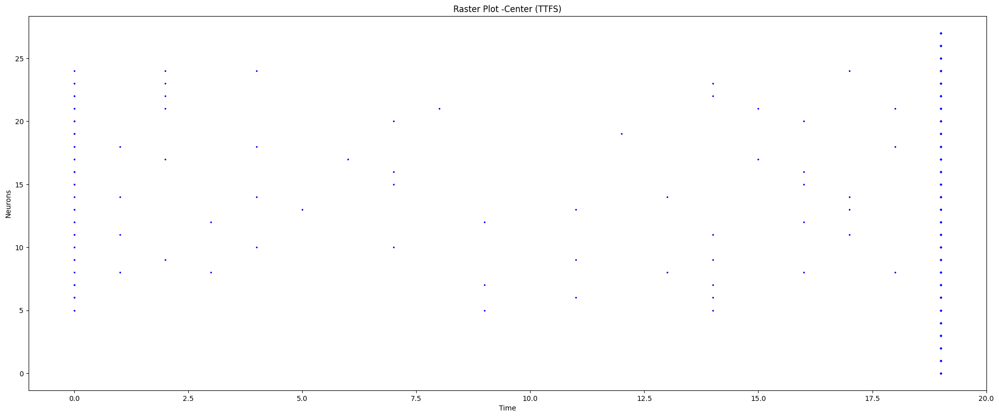

In [915]:
# convolved_on = (convolved_on - convolved_on.min())/(convolved_on.max()-convolved_on.min())
# convolved_off = (convolved_off - convolved_off.min())/(convolved_off.max()-convolved_off.min())

i2l = Intensity2Latency(time_window=TW)
spikes_on_2d = i2l(Xx[3]).squeeze(2).squeeze(1)
rasterPlott(spikes_on_2d, TW)

In [ ]:
import torch
def get_spike_times(spikes):
    first_spike_times = torch.argmax(spikes.long(), dim=0)
    never_spiked_mask = ~torch.any(spikes, dim=0)
    first_spike_times[never_spiked_mask] = -1
    return first_spike_times


(225, 225)


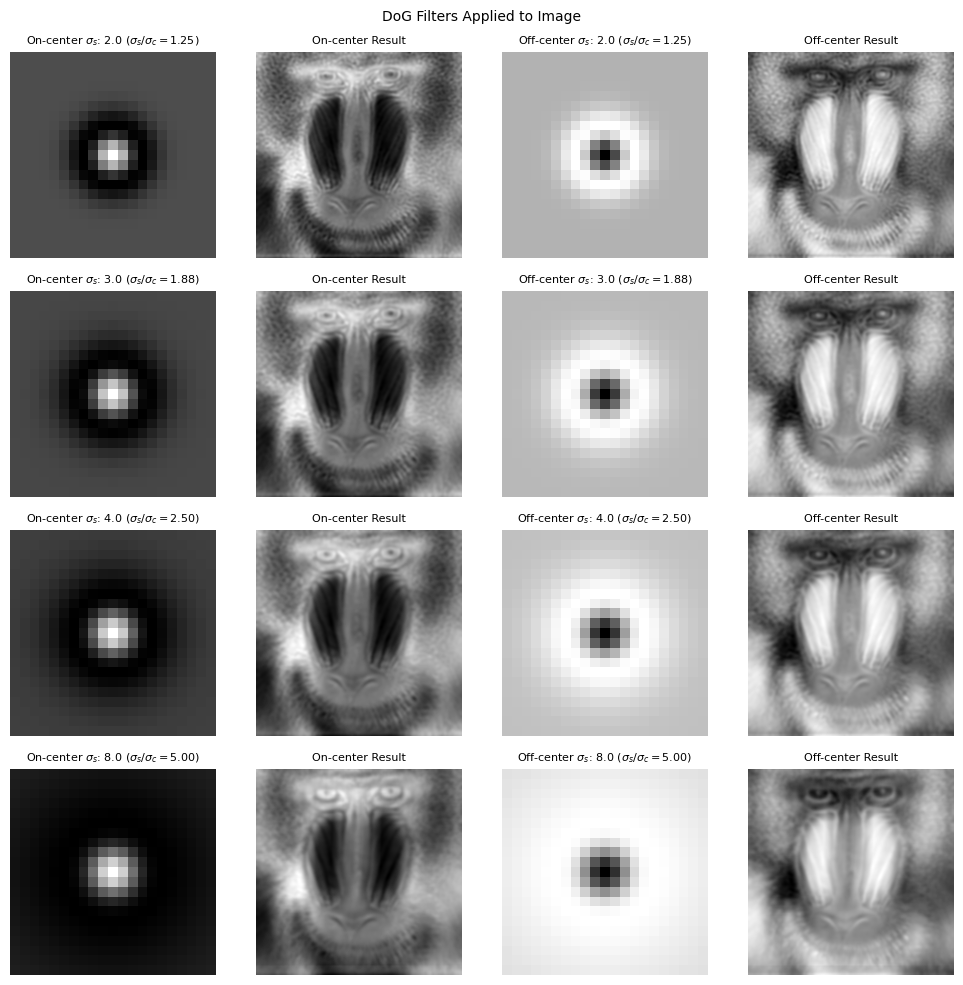

In [854]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import ndimage
from tensorflow.keras.datasets import mnist
from scipy.ndimage import zoom

def dog_filter(size, sigma_center, sigma_surround):
    """Create a Difference of Gaussians (DoG) filter kernel."""
    x, y = np.meshgrid(np.arange(-size//2, size//2+1), np.arange(-size//2, size//2+1))

    center = np.exp(-(x**2 + y**2) / (2 * sigma_center**2)) / sigma_center
    surround = np.exp(-(x**2 + y**2) / (2 * sigma_surround**2)) / sigma_surround

    norm = np.sqrt(2 * np.pi)

    center_norm = center / (2 * np.pi * sigma_center**2)
    surround_norm = surround / (2 * np.pi * sigma_surround**2)
    
    return (center - surround)/norm, (surround - center)/norm


def apply_filter(image, filter_kernel):
    """Apply a filter to an image."""
    return ndimage.convolve(image, filter_kernel, mode='reflect')

# Load the MNIST dataset
IMAGES = ['mandrill.tif']
path = '/Users/macbook/Desktop/CNS/Projects/P05/img'
x_train = np.array([np.array(Image.open(f'{path}/{img}').convert('L').resize((225, 225))) for img in IMAGES])

# x_train = np.array([
#     rgb2gray(resize(img, (112, 112), anti_aliasing=True))
#     for img in X_train[:50]
# ])
# Select a random digit image
random_index = np.random.randint(0, len(x_train))
image = x_train[random_index]
print(image.shape)
# Upscale the image to 254x254
# scale_factor = 254 / 28  # Approximately 9.07
# image_upscaled = zoom(image, scale_factor, order=3)

# Normalize the image
image_upscaled = image / 255.0
# Parameters for DoG filters
size = 20  # Size of the filter kernel
sigma_center = 1.6
sigma_surrounds = [2, 3, 4, 8]  # Ratios between sigma_surround and sigma_center


# Create 5 pairs of DoG filters with different sigma ratios
dog_filters = [dog_filter(size, sigma_center, sigma_surround) for sigma_surround in sigma_surrounds]

# Apply filters and create plots
fig, axes = plt.subplots(4, 4, figsize=(10, 10))
fig.suptitle(f'DoG Filters Applied to Image', fontsize=10)

for i, ((dog_on_center, dog_off_center), sigma_surround) in enumerate(zip(dog_filters, sigma_surrounds)):
    # Apply off-center on-surround filter
    filtered_off_center = apply_filter(image_upscaled, dog_off_center)
    
    # Apply on-center off-surround filter
    filtered_on_center = apply_filter(image_upscaled, dog_on_center)
    
    # Plot off-center on-surround filter kernel
    axes[i, 2].imshow(dog_off_center, cmap='gray')
    axes[i, 2].set_title(f'Off-center $σ_s$: {sigma_surround:.1f} ($σ_s/σ_c=${sigma_surround/sigma_center:.2f})', fontsize=8)
    axes[i, 2].axis('off')
    
    # Plot off-center on-surround result
    axes[i, 3].imshow(filtered_off_center, cmap='gray')
    axes[i, 3].set_title('Off-center Result', fontsize=8)
    axes[i, 3].axis('off')
    
    # Plot on-center off-surround filter kernel
    axes[i, 0].imshow(dog_on_center, cmap='gray')
    axes[i, 0].set_title(f'On-center $σ_s$: {sigma_surround:.1f} ($σ_s/σ_c=${sigma_surround/sigma_center:.2f})', fontsize=8)
    axes[i, 0].axis('off')
    
    # Plot on-center off-surround result
    axes[i, 1].imshow(filtered_on_center, cmap='gray')
    axes[i, 1].set_title('On-center Result', fontsize=8)
    axes[i, 1].axis('off')

plt.tight_layout()
plt.show()


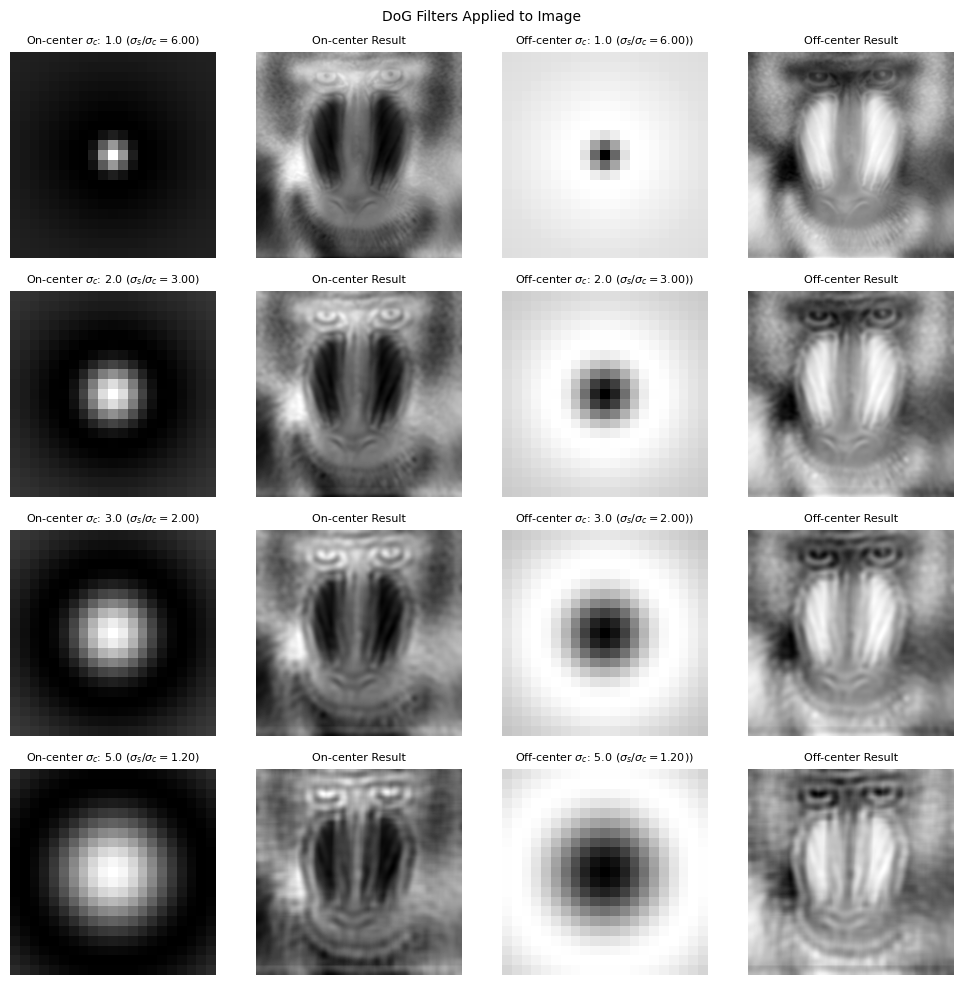

In [855]:
# Select a random digit image
IMAGES = ['mandrill.tif']
path = '/Users/macbook/Desktop/CNS/Projects/P05/img'
x_train = np.array([np.array(Image.open(f'{path}/{img}').convert('L').resize((225, 225))) for img in IMAGES])
random_index = np.random.randint(0, len(x_train))
image = x_train[random_index]

# Upscale the image to 254x254
# scale_factor = 254 / 28  # Approximately 9.07
# image_upscaled = zoom(image, scale_factor, order=3)

# Normalize the image
image_upscaled = image / 255.0

# Parameters for DoG filters
size = 20  # Size of the filter kernel
sigma_surround = 6
sigma_centers = [1, 2, 3, 5]  # Ratios between sigma_surround and sigma_center

# Create 5 pairs of DoG filters with different sigma ratios
dog_filters = [dog_filter(size, sigma_center, sigma_surround) for sigma_center in sigma_centers]

# Apply filters and create plots
fig, axes = plt.subplots(4, 4, figsize=(10, 10))
fig.suptitle(f'DoG Filters Applied to Image', fontsize=10)

for i, ((dog_on_center, dog_off_center), sigma_center) in enumerate(zip(dog_filters, sigma_centers)):
    # Apply off-center on-surround filter
    filtered_off_center = apply_filter(image_upscaled, dog_off_center)
    
    # Apply on-center off-surround filter
    filtered_on_center = apply_filter(image_upscaled, dog_on_center)
    
    # Plot off-center on-surround filter kernel
    axes[i, 2].imshow(dog_off_center, cmap='gray')
    axes[i, 2].set_title(f'Off-center $σ_c$: {sigma_center:.1f} ($σ_s/σ_c=${sigma_surround/sigma_center:.2f}))', fontsize=8)
    axes[i, 2].axis('off')
    
    # Plot off-center on-surround result
    axes[i, 3].imshow(filtered_off_center, cmap='gray')
    axes[i, 3].set_title('Off-center Result', fontsize=8)
    axes[i, 3].axis('off')
    
    # Plot on-center off-surround filter kernel
    axes[i, 0].imshow(dog_on_center, cmap='gray')
    axes[i, 0].set_title(f'On-center $σ_c$: {sigma_center:.1f} ($σ_s/σ_c=${sigma_surround/sigma_center:.2f})', fontsize=8)
    axes[i, 0].axis('off')
    
    # Plot on-center off-surround result
    axes[i, 1].imshow(filtered_on_center, cmap='gray')
    axes[i, 1].set_title('On-center Result', fontsize=8)
    axes[i, 1].axis('off')

plt.tight_layout()
plt.show()


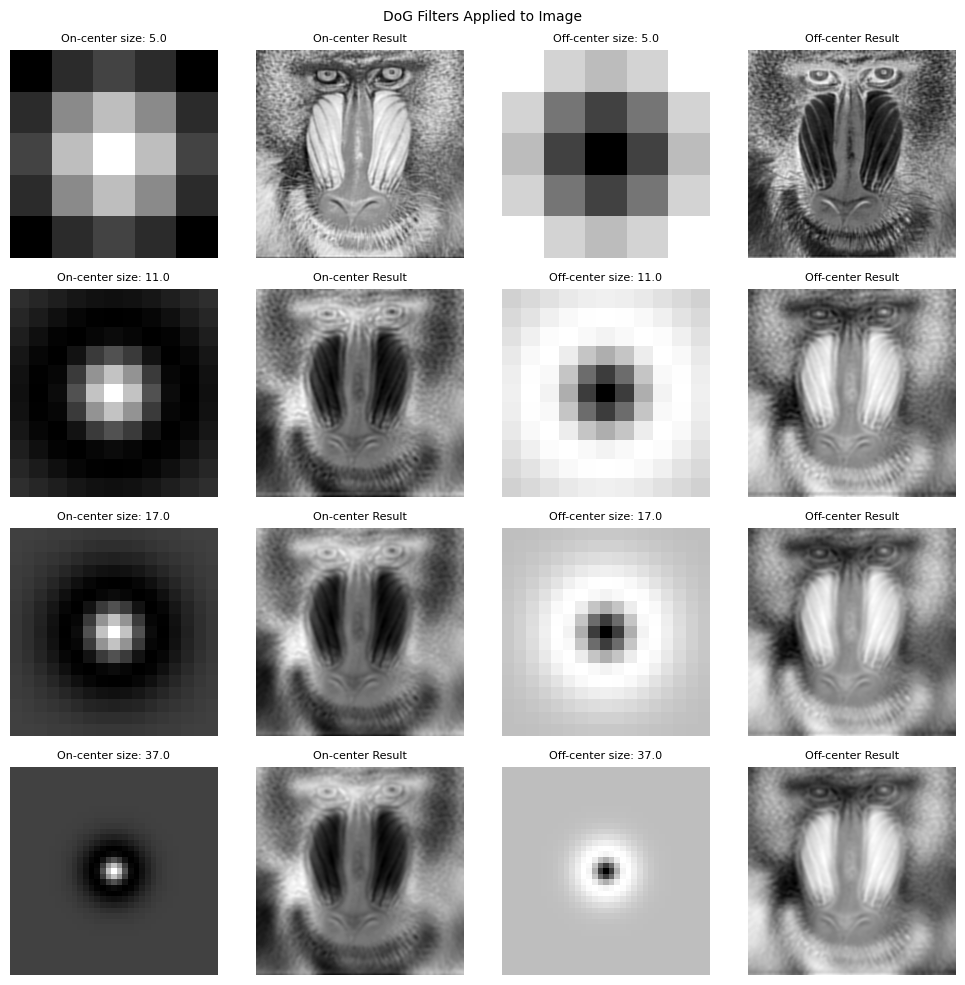

In [856]:
# Select a random digit image
IMAGES = ['mandrill.tif']
path = '/Users/macbook/Desktop/CNS/Projects/P05/img'
x_train = np.array([np.array(Image.open(f'{path}/{img}').convert('L').resize((225, 225))) for img in IMAGES])
random_index = np.random.randint(0, len(x_train))
image = x_train[random_index]

# Upscale the image to 254x254
# scale_factor = 254 / 28  # Approximately 9.07
# image_upscaled = zoom(image, scale_factor, order=3)

# Normalize the image
image_upscaled = image / 255.0

# Parameters for DoG filters
sizes = [4, 10, 16, 36]  # Size of the filter kernel
sigma_surrond = 3.5
sigma_center = 1.5  # Ratios between sigma_surround and sigma_center

# Create 5 pairs of DoG filters with different sigma ratios
dog_filters = [dog_filter(size, sigma_center, sigma_surrond) for size in sizes]

# Apply filters and create plots
fig, axes = plt.subplots(4, 4, figsize=(10, 10))
fig.suptitle(f'DoG Filters Applied to Image', fontsize=10)

for i, ((dog_on_center, dog_off_center), size) in enumerate(zip(dog_filters, sizes)):
    # Apply off-center on-surround filter
    filtered_off_center = apply_filter(image_upscaled, dog_off_center)
    
    # Apply on-center off-surround filter
    filtered_on_center = apply_filter(image_upscaled, dog_on_center)
    
    # Plot off-center on-surround filter kernel
    axes[i, 2].imshow(dog_off_center, cmap='gray')
    axes[i, 2].set_title(f'Off-center size: {size+1:.1f}', fontsize=8)
    axes[i, 2].axis('off')
    
    # Plot off-center on-surround result
    axes[i, 3].imshow(filtered_off_center, cmap='gray')
    axes[i, 3].set_title('Off-center Result', fontsize=8)
    axes[i, 3].axis('off')
    
    # Plot on-center off-surround filter kernel
    axes[i, 0].imshow(dog_on_center, cmap='gray')
    axes[i, 0].set_title(f'On-center size: {size+1:.1f}', fontsize=8)
    axes[i, 0].axis('off')
    
    # Plot on-center off-surround result
    axes[i, 1].imshow(filtered_on_center, cmap='gray')
    axes[i, 1].set_title('On-center Result', fontsize=8)
    axes[i, 1].axis('off')

plt.tight_layout()
plt.show()


### Gabor

(225, 225)


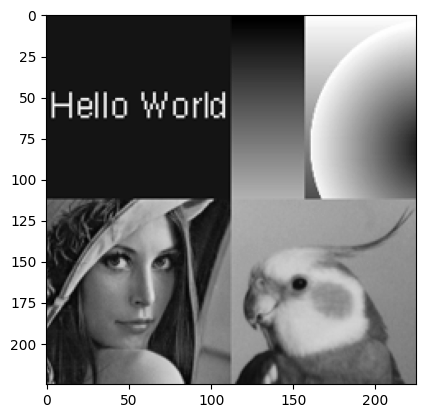

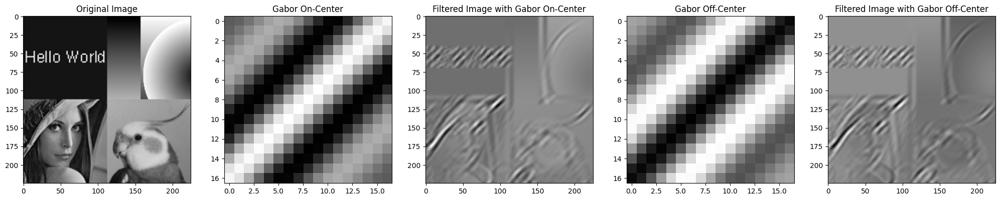

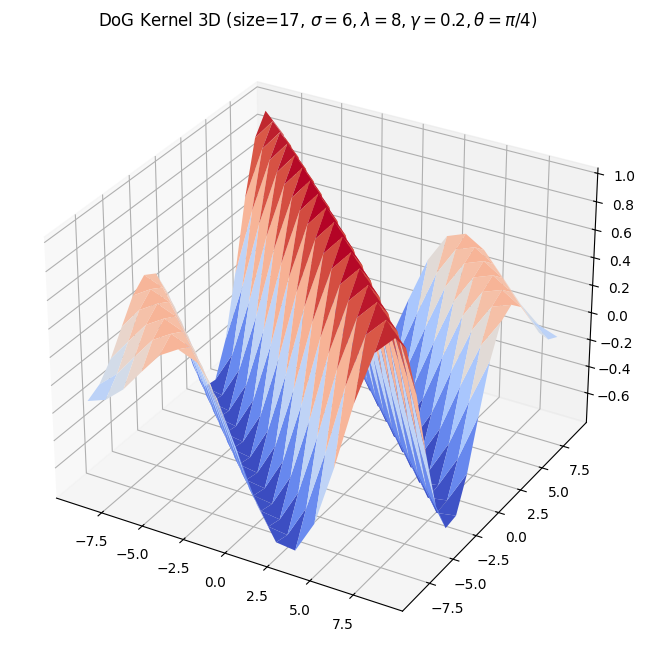

In [857]:

TW=25
IMAGES = ['montage.tif']
path = '/Users/macbook/Desktop/CNS/Projects/P05/img'
x_train = np.array([np.array(Image.open(f'{path}/{img}').convert('L').resize((225, 225))) for img in IMAGES])
image_upscaled = x_train / 255.0
Xx = torch.tensor(image_upscaled, dtype=torch.float32)
# x_train = np.array([
#     rgb2gray(resize(img, (112, 112), anti_aliasing=True))
#     for img in X_train[:50]
# ])
# Select a random digit image
random_index = np.random.randint(0, len(x_train))
image = Xx[random_index]
image_tensor = image.unsqueeze(0).unsqueeze(0)

IMAGES = ['montage.tif']
path = '/Users/macbook/Desktop/CNS/Projects/P05/img'
x_train = np.array([np.array(Image.open(f'{path}/{img}').convert('L').resize((225, 225))) for img in IMAGES])

# x_train = np.array([
#     rgb2gray(resize(img, (112, 112), anti_aliasing=True))
#     for img in X_train[:50]
# ])
# Select a random digit image
random_index = np.random.randint(0, len(x_train))
image = x_train[random_index]
print(image.shape)
image_upscaled = image / 255.0
plt.imshow(image_upscaled, cmap='gray')

# gabor_on = GaborFilter(size=17, sigma=6, labda=6, theta=np.pi/2, gamma=1.0,  dtype=torch.float32).clone().detach().unsqueeze(0).unsqueeze(0)
# gabor_off = -gabor_on
# convFilter_off = Conv2dFilter(filters=gabor_off, padding='same')
# image_conv_off_gabor = convFilter_off(input=image_tensor)

# convFilter_on = Conv2dFilter(filters=gabor_on, padding='same')
# image_conv_on_gabor = convFilter_off(input=image_tensor)


# plt.figure(figsize=(25, 5))
# plt.subplot(151), plt.imshow(image_upscaled, cmap='gray'), plt.title('Original Image')
# plt.subplot(152), plt.imshow(gabor_on.squeeze(0).squeeze(0), cmap='gray'), plt.title('Gabor On-Center')
# plt.subplot(153), plt.imshow(image_conv_on_gabor.squeeze(0).squeeze(0), cmap='gray'), plt.title('Filtered Image with Gabor On-Center')
# plt.subplot(154), plt.imshow(gabor_off.squeeze(0).squeeze(0), cmap='gray'), plt.title('Gabor Off-Center')
# plt.subplot(155), plt.imshow(image_conv_off_gabor.squeeze(0).squeeze(0), cmap='gray'), plt.title('Filtered Image with Gabor Off-Center')
# plt.show()
# print(gabor_off.shape)



size = 16  # Increased size for larger images
lambda_ = 8
sigma = 6
psi = 0
gamma = 0.2
theta = np.pi/4


gabor = gabor_filter(size, sigma, theta, lambda_, gamma, psi)
filtered_on = apply_filter(image_upscaled, gabor)
filtered_off = apply_filter(image_upscaled, -gabor)


plt.figure(figsize=(25, 5))
plt.subplot(151), plt.imshow(image_upscaled, cmap='gray'), plt.title('Original Image')
plt.subplot(152), plt.imshow(gabor, cmap='gray'), plt.title('Gabor On-Center')
plt.subplot(153), plt.imshow(filtered_on, cmap='gray'), plt.title('Filtered Image with Gabor On-Center')
plt.subplot(154), plt.imshow(-gabor, cmap='gray'), plt.title('Gabor Off-Center')
plt.subplot(155), plt.imshow(filtered_off, cmap='gray'), plt.title('Filtered Image with Gabor Off-Center')
plt.show()

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')
x = y = np.linspace(-(size+1)//2, (size+1)//2+1, (size+1))
X, Y = np.meshgrid(x, y)
ax.plot_surface(X, Y, gabor, cmap='coolwarm')
ax.set_title(f'DoG Kernel 3D (size={size+1}, $\sigma={sigma}, \lambda={lambda_}, \gamma={gamma}, θ=\pi/4 $)')
plt.show()


(225, 225)


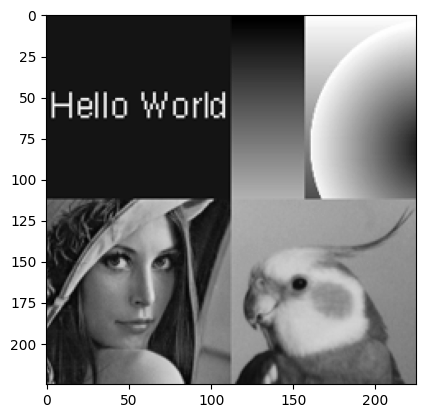

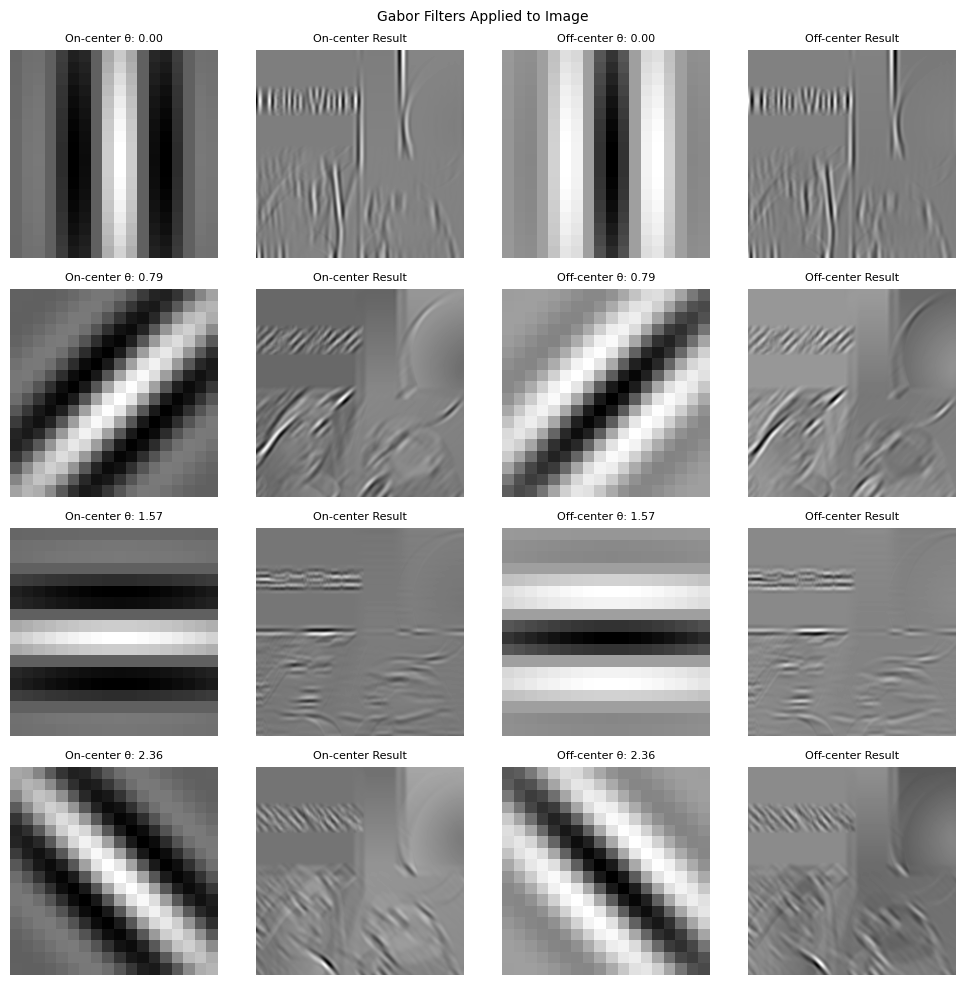

In [858]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import ndimage
from tensorflow.keras.datasets import cifar10
from scipy.ndimage import zoom
from skimage.transform import resize
from skimage.color import rgb2gray

def gabor_filter(size, sigma, theta, lambda_, gamma, psi):
    """Create a Gabor filter kernel."""
    x, y = np.meshgrid(np.arange(-size//2, size//2+1), np.arange(-size//2, size//2+1))
    
    x_theta = x * np.cos(theta) + y * np.sin(theta)
    y_theta = -x * np.sin(theta) + y * np.cos(theta)
    
    gb = np.exp(-(x_theta**2 + gamma**2 * y_theta**2) / (2 * sigma**2)) * np.cos(2 * np.pi * x_theta / lambda_ + psi)
    
    return gb

def apply_filter(image, filter_kernel):
    """Apply a filter to an image."""
    return ndimage.convolve(image, filter_kernel, mode='reflect')

# Load the MNIST dataset
IMAGES = ['montage.tif']
path = '/Users/macbook/Desktop/CNS/Projects/P05/img'
x_train = np.array([np.array(Image.open(f'{path}/{img}').convert('L').resize((225, 225))) for img in IMAGES])

# x_train = np.array([
#     rgb2gray(resize(img, (112, 112), anti_aliasing=True))
#     for img in X_train[:50]
# ])
# Select a random digit image
random_index = np.random.randint(0, len(x_train))
image = x_train[random_index]
print(image.shape)
image_upscaled = image / 255.0
plt.imshow(image_upscaled, cmap='gray')

# Parameters for Gabor filters
size = 17  # Increased size for larger images
lambda_ = 8
sigma = 4
psi = 0
gamma = 0.4
theta = np.pi/4

# Create 4 Gabor filters with different orientations
orientations = [0, np.pi/4, np.pi/2, 3*np.pi/4]
gabor_filters = [gabor_filter(size, sigma, theta, lambda_, gamma, psi) for theta in orientations]

# Apply filters and create plots
fig, axes = plt.subplots(4, 4, figsize=(10, 10))
fig.suptitle(f'Gabor Filters Applied to Image', fontsize=10)

for i, (gabor, theta) in enumerate(zip(gabor_filters, orientations)):
    # On-center Gabor filter
    filtered_on = apply_filter(image_upscaled, gabor)
    
    # Off-center Gabor filter
    filtered_off = apply_filter(image_upscaled, -gabor)
    
    # Plot on-center filter kernel
    axes[i, 0].imshow(gabor, cmap='gray')
    axes[i, 0].set_title(f'On-center θ: {theta:.2f}', fontsize=8)
    axes[i, 0].axis('off')
    
    # Plot off-center filter kernel
    axes[i, 2].imshow(-gabor, cmap='gray')
    axes[i, 2].set_title(f'Off-center θ: {theta:.2f}', fontsize=8)
    axes[i, 2].axis('off')
    
    # Plot on-center result
    axes[i, 1].imshow(filtered_on, cmap='gray')
    axes[i, 1].set_title('On-center Result', fontsize=8)
    axes[i, 1].axis('off')
    
    # Plot off-center result
    axes[i, 3].imshow(filtered_off, cmap='gray')
    axes[i, 3].set_title('Off-center Result', fontsize=8)
    axes[i, 3].axis('off')


plt.tight_layout()
plt.show()


(225, 225)


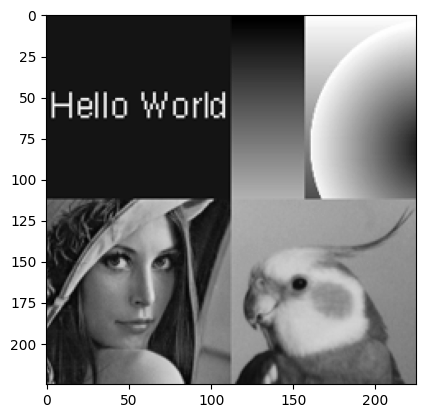

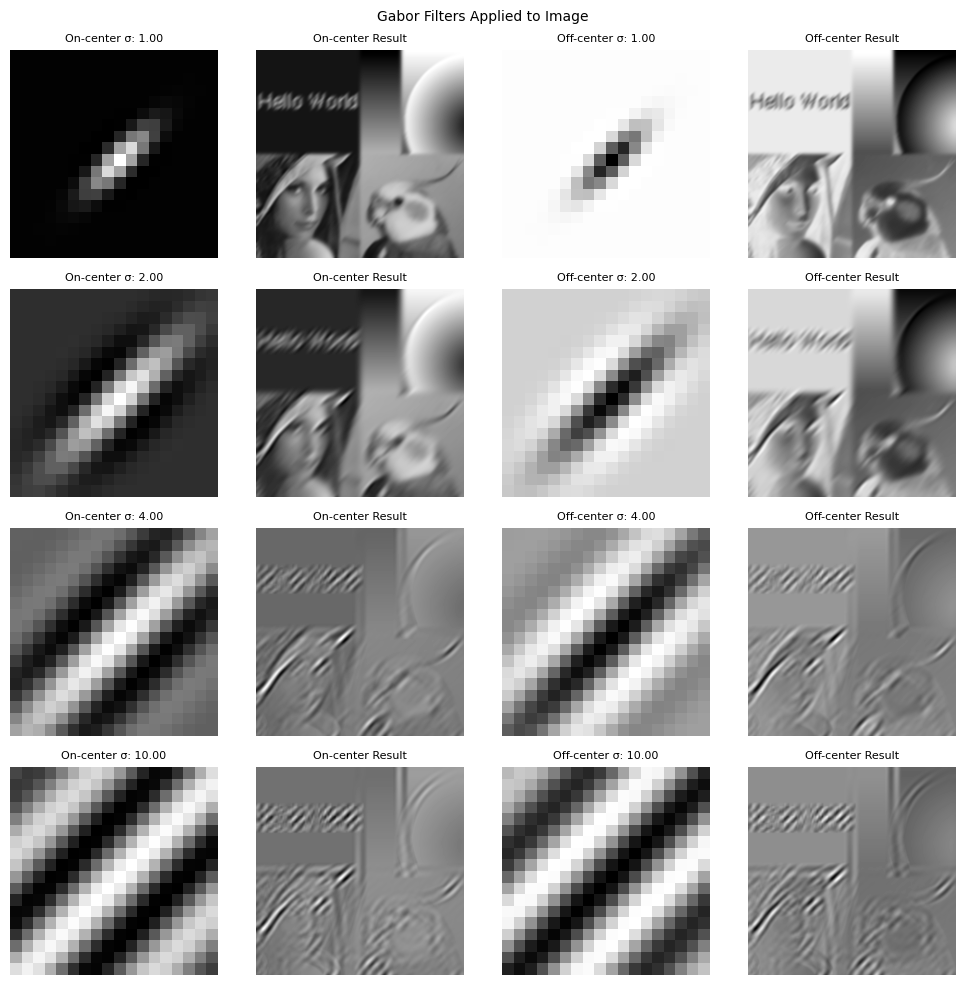

In [859]:
# Select a random digit image
IMAGES = ['montage.tif']
path = '/Users/macbook/Desktop/CNS/Projects/P05/img'
x_train = np.array([np.array(Image.open(f'{path}/{img}').convert('L').resize((225, 225))) for img in IMAGES])

# x_train = np.array([
#     rgb2gray(resize(img, (112, 112), anti_aliasing=True))
#     for img in X_train[:50]
# ])
# Select a random digit image
random_index = np.random.randint(0, len(x_train))
image = x_train[random_index]
print(image.shape)
image_upscaled = image / 255.0
plt.imshow(image_upscaled, cmap='gray')


size = 17  # Increased size for larger images
lambda_ = 8
gamma = 0.4
psi = 0
theta = np.pi/4

# Create 5 Gabor filters with different orientations
sigmas = [1, 2, 4, 10]
gabor_filters = [gabor_filter(size, sigma, theta, lambda_, gamma, psi) for sigma in sigmas]

# Apply filters and create plots
fig, axes = plt.subplots(4, 4, figsize=(10, 10))
fig.suptitle(f'Gabor Filters Applied to Image', fontsize=10)

for i, (gabor, sigma) in enumerate(zip(gabor_filters, sigmas)):
    # On-center Gabor filter
    filtered_on = apply_filter(image_upscaled, gabor)
    
    # Off-center Gabor filter
    filtered_off = apply_filter(image_upscaled, -gabor)
    
    # Plot on-center filter kernel
    axes[i, 0].imshow(gabor, cmap='gray')
    axes[i, 0].set_title(f'On-center σ: {sigma:.2f}', fontsize=8)
    axes[i, 0].axis('off')
    
    # Plot off-center filter kernel
    axes[i, 2].imshow(-gabor, cmap='gray')
    axes[i, 2].set_title(f'Off-center σ: {sigma:.2f}', fontsize=8)
    axes[i, 2].axis('off')
    
    # Plot on-center result
    axes[i, 1].imshow(filtered_on, cmap='gray')
    axes[i, 1].set_title('On-center Result', fontsize=8)
    axes[i, 1].axis('off')
    
    # Plot off-center result
    axes[i, 3].imshow(filtered_off, cmap='gray')
    axes[i, 3].set_title('Off-center Result', fontsize=8)
    axes[i, 3].axis('off')


plt.tight_layout()
plt.show()


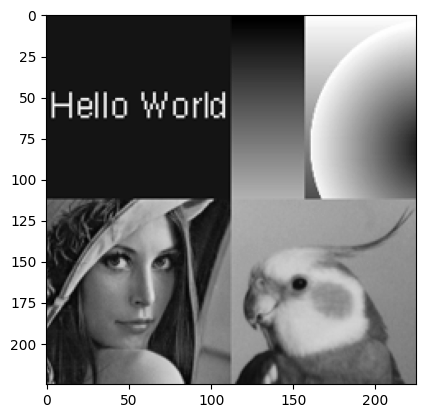

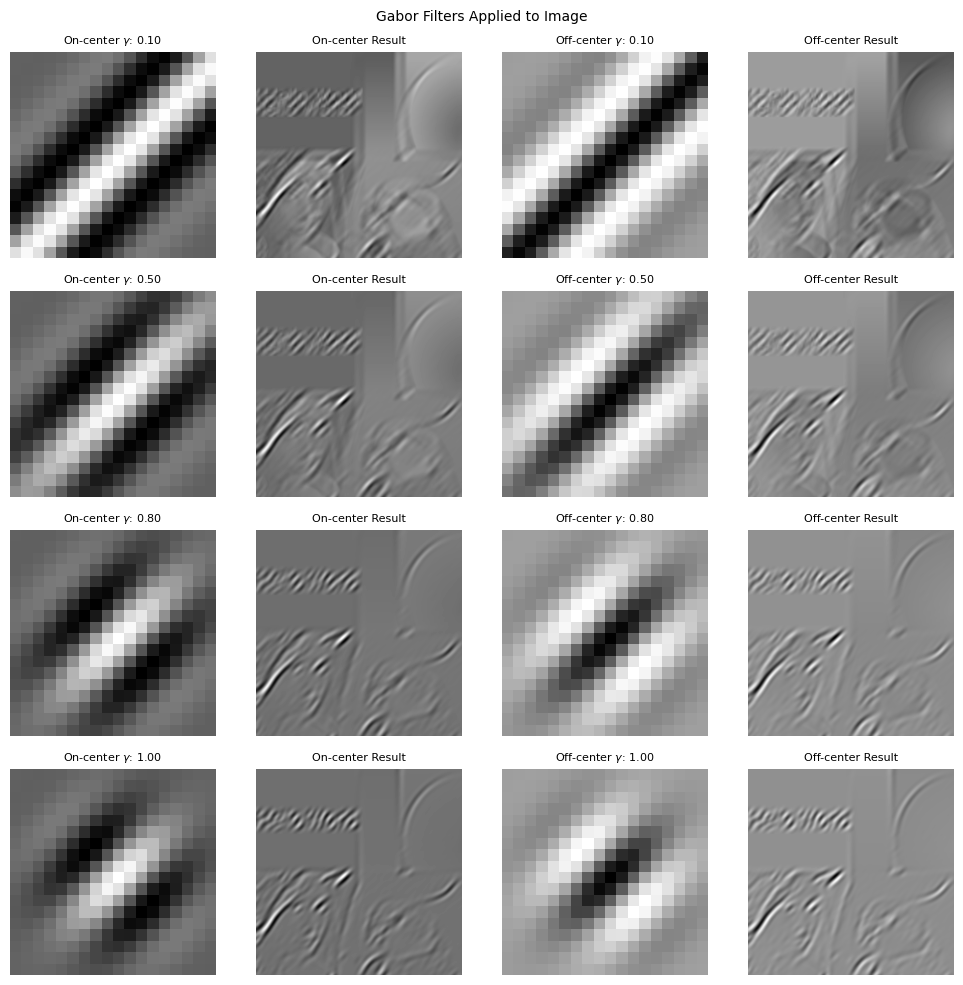

In [860]:
# Select a random digit image
# Select a random digit image
IMAGES = ['montage.tif']
path = '/Users/macbook/Desktop/CNS/Projects/P05/img'
x_train = np.array([np.array(Image.open(f'{path}/{img}').convert('L').resize((225, 225))) for img in IMAGES])
random_index = np.random.randint(0, len(x_train))
image = x_train[random_index]
# Normalize the image
image_upscaled = image / 255.0
plt.imshow(image_upscaled, cmap='gray')

# Parameters for Gabor filters

size = 17  # Increased size for larger images
lambda_ = 8
sigma = 4
psi = 0
theta = np.pi/4

# Create 5 Gabor filters with different orientations
gammas = [0.1, 0.5, 0.8, 1.0]
gabor_filters = [gabor_filter(size, sigma, theta, lambda_, gamma, psi) for gamma in gammas]

# Apply filters and create plots
fig, axes = plt.subplots(4, 4, figsize=(10, 10))
fig.suptitle(f'Gabor Filters Applied to Image', fontsize=10)

for i, (gabor, gamma) in enumerate(zip(gabor_filters, gammas)):
    # On-center Gabor filter
    filtered_on = apply_filter(image_upscaled, gabor)
    
    # Off-center Gabor filter
    filtered_off = apply_filter(image_upscaled, -gabor)
    
    # Plot on-center filter kernel
    axes[i, 0].imshow(gabor, cmap='gray')
    axes[i, 0].set_title(f'On-center $\gamma$: {gamma:.2f}', fontsize=8)
    axes[i, 0].axis('off')
    
    # Plot off-center filter kernel
    axes[i, 2].imshow(-gabor, cmap='gray')
    axes[i, 2].set_title(f'Off-center $\gamma$: {gamma:.2f}', fontsize=8)
    axes[i, 2].axis('off')
    
    # Plot on-center result
    axes[i, 1].imshow(filtered_on, cmap='gray')
    axes[i, 1].set_title('On-center Result', fontsize=8)
    axes[i, 1].axis('off')
    
    # Plot off-center result
    axes[i, 3].imshow(filtered_off, cmap='gray')
    axes[i, 3].set_title('Off-center Result', fontsize=8)
    axes[i, 3].axis('off')


plt.tight_layout()
plt.show()


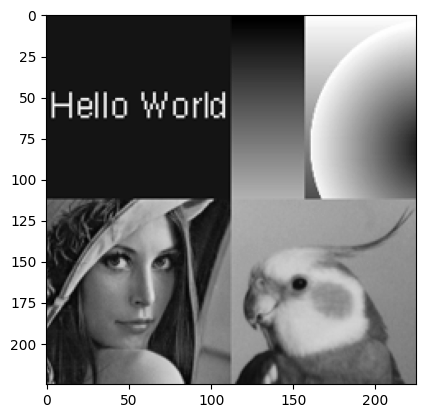

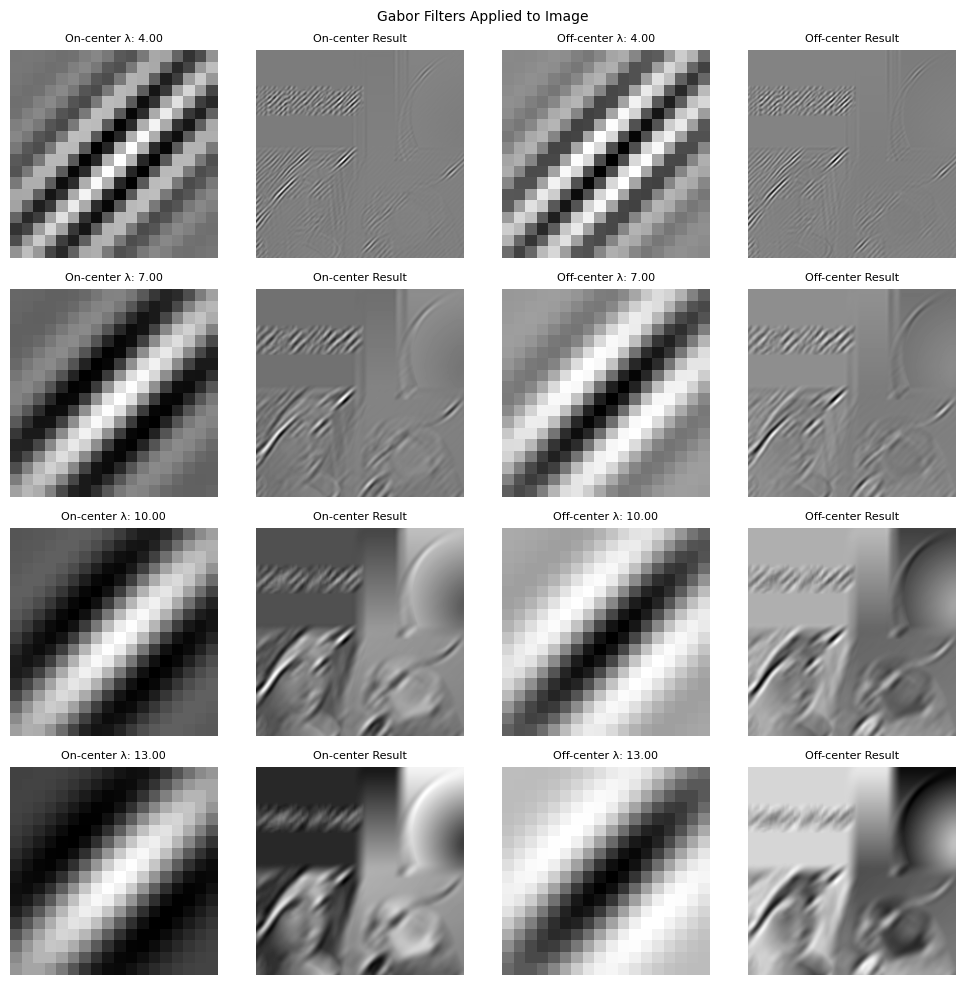

In [861]:
# Select a random digit image
# Select a random digit image
IMAGES = ['montage.tif']
path = '/Users/macbook/Desktop/CNS/Projects/P05/img'
x_train = np.array([np.array(Image.open(f'{path}/{img}').convert('L').resize((225, 225))) for img in IMAGES])
random_index = np.random.randint(0, len(x_train))
image = x_train[random_index]

image_upscaled = image / 255.0
plt.imshow(image_upscaled, cmap='gray')

# Parameters for Gabor filters
size = 17  # Increased size for larger images
gamma = 0.4
sigma = 4
psi = 0
theta = np.pi/4


# Create 5 Gabor filters with different orientations
lambdas = [4, 7, 10, 13]
gabor_filters = [gabor_filter(size, sigma, theta, lambda_, gamma, psi) for lambda_ in lambdas]

# Apply filters and create plots
fig, axes = plt.subplots(4, 4, figsize=(10, 10))
fig.suptitle(f'Gabor Filters Applied to Image', fontsize=10)

for i, (gabor, lambda_) in enumerate(zip(gabor_filters, lambdas)):
    # On-center Gabor filter
    filtered_on = apply_filter(image_upscaled, gabor)
    
    # Off-center Gabor filter
    filtered_off = apply_filter(image_upscaled, -gabor)
    
    # Plot on-center filter kernel
    axes[i, 0].imshow(gabor, cmap='gray')
    axes[i, 0].set_title(f'On-center λ: {lambda_:.2f}', fontsize=8)
    axes[i, 0].axis('off')
    
    # Plot off-center filter kernel
    axes[i, 2].imshow(-gabor, cmap='gray')
    axes[i, 2].set_title(f'Off-center λ: {lambda_:.2f}', fontsize=8)
    axes[i, 2].axis('off')
    
    # Plot on-center result
    axes[i, 1].imshow(filtered_on, cmap='gray')
    axes[i, 1].set_title('On-center Result', fontsize=8)
    axes[i, 1].axis('off')
    
    # Plot off-center result
    axes[i, 3].imshow(filtered_off, cmap='gray')
    axes[i, 3].set_title('Off-center Result', fontsize=8)
    axes[i, 3].axis('off')


plt.tight_layout()
plt.show()


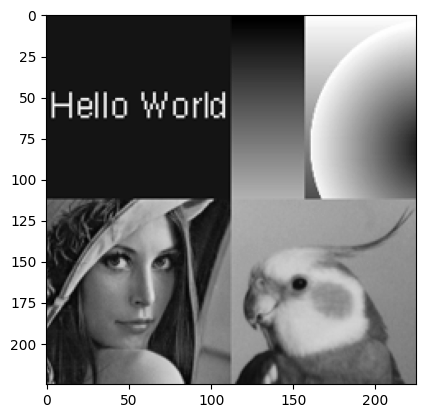

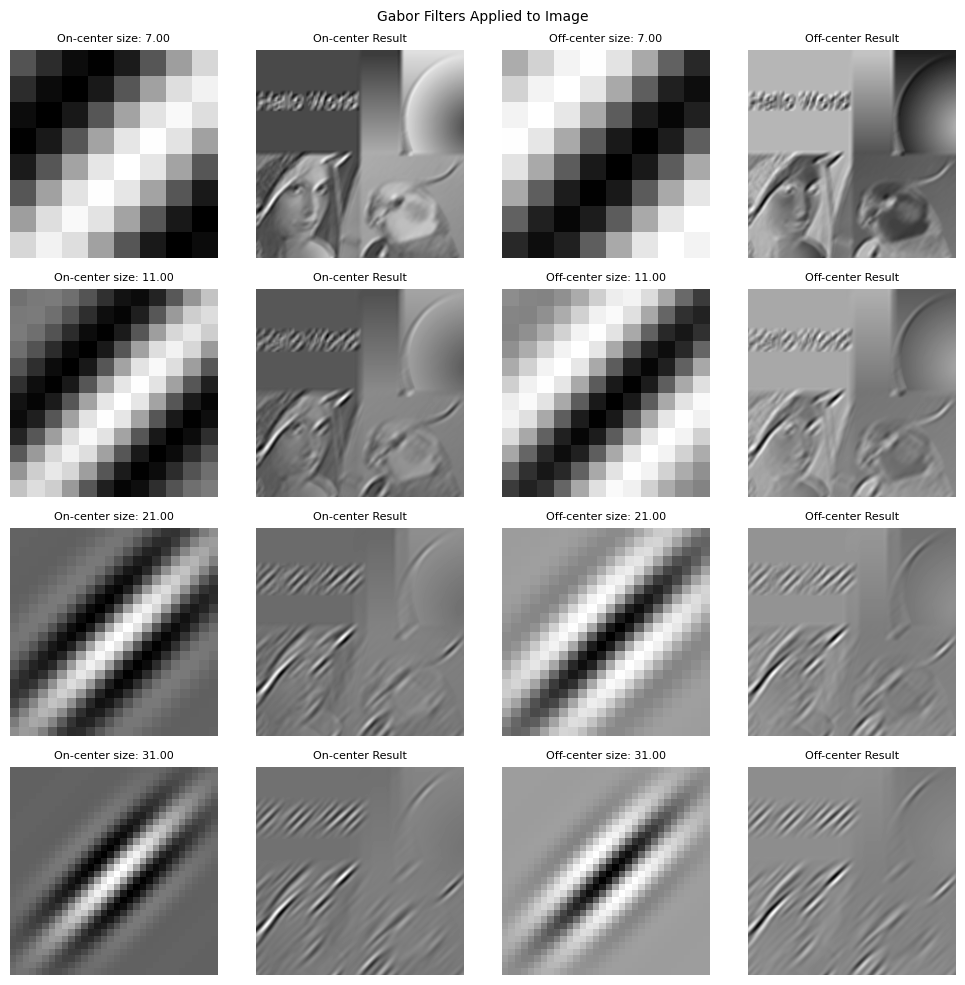

In [862]:
# Select a random digit image
IMAGES = ['montage.tif']
path = '/Users/macbook/Desktop/CNS/Projects/P05/img'
x_train = np.array([np.array(Image.open(f'{path}/{img}').convert('L').resize((225, 225))) for img in IMAGES])
random_index = np.random.randint(0, len(x_train))
image = x_train[random_index]
plt.imshow(image_upscaled, cmap='gray')

# Parameters for Gabor filters
gamma = 0.4
sigma = 4
lambda_ = 8
psi = 0
theta = np.pi/4

sizes = [7, 11, 21, 31]
gabor_filters = [gabor_filter(size, sigma, theta, lambda_, gamma, psi) for size in sizes]

# Apply filters and create plots
fig, axes = plt.subplots(4, 4, figsize=(10, 10))
fig.suptitle(f'Gabor Filters Applied to Image', fontsize=10)

for i, (gabor, size) in enumerate(zip(gabor_filters, sizes)):
    # On-center Gabor filter
    filtered_on = apply_filter(image_upscaled, gabor)
    
    # Off-center Gabor filter
    filtered_off = apply_filter(image_upscaled, -gabor)
    
    # Plot on-center filter kernel
    axes[i, 0].imshow(gabor, cmap='gray')
    axes[i, 0].set_title(f'On-center size: {size:.2f}', fontsize=8)
    axes[i, 0].axis('off')
    
    # Plot off-center filter kernel
    axes[i, 2].imshow(-gabor, cmap='gray')
    axes[i, 2].set_title(f'Off-center size: {size:.2f}', fontsize=8)
    axes[i, 2].axis('off')
    
    # Plot on-center result
    axes[i, 1].imshow(filtered_on, cmap='gray')
    axes[i, 1].set_title('On-center Result', fontsize=8)
    axes[i, 1].axis('off')
    
    # Plot off-center result
    axes[i, 3].imshow(filtered_off, cmap='gray')
    axes[i, 3].set_title('Off-center Result', fontsize=8)
    axes[i, 3].axis('off')


plt.tight_layout()
plt.show()


### idk

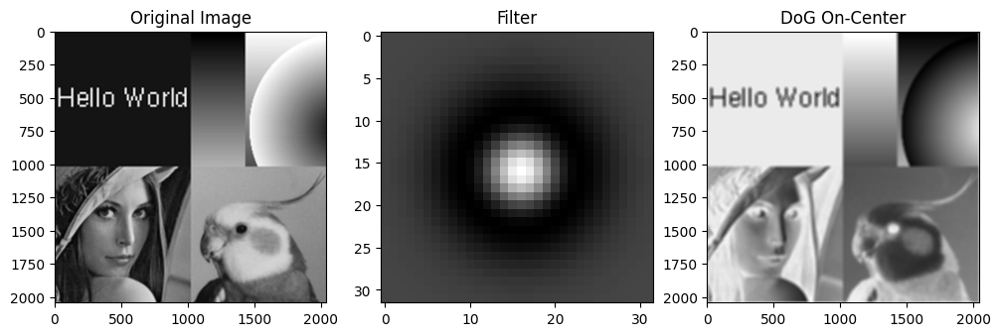

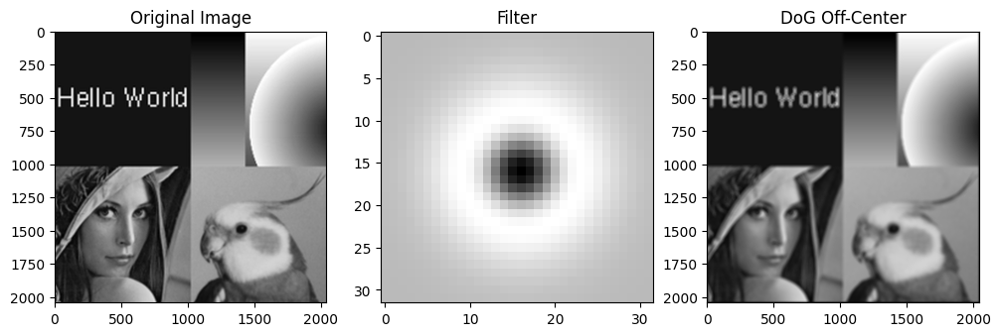

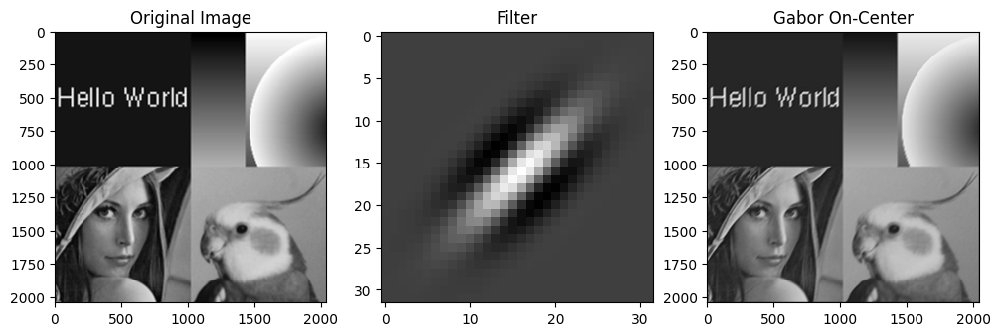

KeyboardInterrupt: 

In [863]:
# Select a random digit image
random_index = np.random.randint(0, len(x_train))
image = x_train[random_index]

# Upscale the image to 254x254
scale_factor = 254 / 28  # Approximately 9.07
image_upscaled = zoom(image, scale_factor, order=3)

# Normalize the image
image = image_upscaled / 255.0

# Create and apply DoG filters
dog_on_center, dog_off_center = dog_filter(31, 3, 6)

filtered_dog_on = apply_and_show_filter(image, dog_on_center, 'DoG On-Center')
filtered_dog_off = apply_and_show_filter(image, dog_off_center, 'DoG Off-Center')

# Create and apply Gabor filters
gabor_on_center = gabor_filter(31, 3, np.pi/4, 10, 0.5, 0)
gabor_off_center = -gabor_on_center

filtered_gabor_on = apply_and_show_filter(image, gabor_on_center, 'Gabor On-Center')
filtered_gabor_off = apply_and_show_filter(image, gabor_off_center, 'Gabor Off-Center')


In [ ]:
import torch

def scaleImage(img, mn=0., mx=255.):
    image = img.copy()
    image_normalized = (image - image.min()) / (image.max() - image.min())
    image_scaled = image_normalized * (mx - mn) + mn
    return image_scaled

# Time-to-First-Spike encoding function
def time_to_first_spike(filtered_image, iter):
    filtered_image = scaleImage(filtered_image)
    time_to_spike = np.zeros_like(filtered_image)
    spikes = torch.Tensor(iter, *np.shape(filtered_image), device="cpu")

    bib = abs(filtered_image - 255.) * (iter - 1) // 255
    for t in range(iter):  # Assume maximum of 100 time steps
        spikes_bool = (bib == t)
        time_to_spike[spikes_bool] = t
        spikes[t] = torch.from_numpy(spikes_bool)
    return time_to_spike, spikes

# Time-to-First-Spike encoding function
def time_to_first_spike2(filtered_image, threshold, iter):
    time_to_spike = np.zeros_like(filtered_image)
    spikes = torch.Tensor(iter, *np.shape(filtered_image), device="cpu")

    for t in range(1, iter+1):  # Assume maximum of 100 time steps
        spiked = (filtered_image >= threshold) & (time_to_spike == 0)
        time_to_spike[spiked] = t
        spikes[t-1] = torch.from_numpy(spiked)
        threshold *= 0.99  # Decrease threshold at each time step
    return time_to_spike, spikes

def raster_plot(spike_times):
    plt.figure(figsize=(20,8))
    plt.scatter(torch.nonzero(spike_times, as_tuple=True)[0], torch.nonzero(spike_times, as_tuple=True)[1], s=2)
    plt.xlabel("Time")
    plt.ylabel("Neurons")
    plt.title('Raster Plot')
    plt.show()
    
def raster_plot2(spike_times):
    plt.figure(figsize=(12, 6))
    for i, row in enumerate(spike_times):
        for j, spike_time in enumerate(row):
            if spike_time > 0:
                plt.plot(spike_time, i * len(row) + j, 'k.', markersize=1)
    plt.xlabel('Time')
    plt.ylabel('Neuron Index')
    plt.title('Raster Plot of Time-to-First-Spike')
    plt.show()


In [ ]:

tw=100
spike_times_dog_on, spikes_dog_on = time_to_first_spike2(filtered_dog_on, np.max(filtered_dog_on) * 0.5, tw)
spike_times_dog_off, spikes_dog_off = time_to_first_spike2(filtered_dog_off, np.max(filtered_dog_off) * 0.5, tw)
spike_times_gabor_on, spikes_gabor_on = time_to_first_spike2(filtered_gabor_on, np.max(filtered_gabor_on) * 0.5, tw)
spike_times_gabor_off, spikes_gabor_off = time_to_first_spike2(filtered_gabor_off, np.max(filtered_gabor_off) * 0.5, tw)


# Display Time-to-First-Spike encoding results
plt.figure(figsize=(16, 4))
plt.subplot(117), plt.imshow(spike_times_dog_on, cmap='viridis'), plt.title('DoG On-Center')
plt.subplot(142), plt.imshow(spike_times_dog_off, cmap='viridis'), plt.title('DoG Off-Center')
plt.subplot(143), plt.imshow(spike_times_gabor_on, cmap='viridis'), plt.title('Gabor On-Center')
plt.subplot(144), plt.imshow(spike_times_gabor_off, cmap='viridis'), plt.title('Gabor Off-Center')
plt.colorbar()
plt.show()

# Create raster plots
raster_plot(spikes_dog_on)
raster_plot(spikes_dog_off)
raster_plot(spikes_gabor_on)
raster_plot(spikes_gabor_off)



In [ ]:
# Apply Time-to-First-Spike encoding
time_window = 100

spike_times_dog_on, spikes_dog_on = time_to_first_spike(filtered_dog_on, time_window)
spike_times_dog_off, spikes_dog_off = time_to_first_spike(filtered_dog_off, time_window)
spike_times_gabor_on, spikes_gabor_on = time_to_first_spike(filtered_gabor_on, time_window)
spike_times_gabor_off, spikes_gabor_off = time_to_first_spike(filtered_gabor_off, time_window)

# Display Time-to-First-Spike encoding results
plt.figure(figsize=(18, 4))
plt.subplot(117), plt.imshow(spike_times_dog_on, cmap='gray'), plt.title('DoG On-Center')
plt.subplot(142), plt.imshow(spike_times_dog_off, cmap='gray'), plt.title('DoG Off-Center')
plt.subplot(143), plt.imshow(spike_times_gabor_on, cmap='gray'), plt.title('Gabor On-Center')
plt.subplot(144), plt.imshow(spike_times_gabor_off, cmap='gray'), plt.title('Gabor Off-Center')
plt.colorbar()
plt.tight_layout()
plt.show()

# Create raster plots
raster_plot(spikes_dog_on)
raster_plot(spikes_dog_off)
raster_plot(spikes_gabor_on)
raster_plot(spikes_gabor_off)

In [ ]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch
import matplotlib.pyplot as plt
import numpy as np
import torch.nn as nn
import tensorflow as tf
from skimage.transform import resize
from skimage.color import rgb2gray
from scipy import ndimage


import math
import cv2
from PIL import Image
import torch.nn.functional as F


from pymonntorch import (
      NeuronDimension,
      Behavior, 
      Network, 
      Recorder,
      EventRecorder,
      NeuronGroup,
      SynapseGroup
)

from conex.behaviors.neurons import (
    SimpleDendriteStructure,
    SimpleDendriteComputation,
    SpikeTrace,
    NeuronAxon,
    LIF,
    Fire,
    KWTA,
    VoltageBaseHomeostasis,
    ActivityBaseHomeostasis,
)
from conex.behaviors.synapses import (
    SynapseInit,
    WeightInitializer,
    WeightClip,
    SimpleDendriticInput,
    Conv2dDendriticInput,
    AveragePool2D,
    BaseDendriticInput,
    LateralDendriticInput,
    SimpleSTDP,
    Conv2dSTDP,
    Local2dSTDP,
    CurrentNormalization,
    BaseLearning
)

from conex.helpers.filters import (
    DoGFilter,
    GaborFilter
)

from conex.helpers.transforms import (
    Conv2dFilter,
    AbsoluteTransform,
    Poisson,
    SimplePoisson,
    Intensity2Latency
)

In [ ]:
def ttfs_step(firings, TW, title=''):
    firings = firings.float()
    firings *= 255
    firings = abs(firings - 255)
    
    fig, axs = plt.subplots(5,5, figsize=(10, 10))
    # fig.subplots_adjust(hspace = .5, wspace=.001)

    axs = axs.ravel()

    for i in range(TW):
        step = np.array(firings[i])
        if (step - 255).sum() == 0:
            axs[i].imshow(torch.zeros((225, 225)), cmap='binary')
            axs[i].set_title('Time' + str(i))
            axs[i].tick_params(left = False, right = False , labelleft = False ,
                labelbottom = False, bottom = False)
        else:
            axs[i].imshow(step, cmap='gray')
            axs[i].set_title('Time' + str(i))
            axs[i].tick_params(left = False, right = False , labelleft = False ,
                labelbottom = False, bottom = False)
    fig.suptitle(f'Spikes Per Iteration {title}-Center')

In [ ]:
def plotstuff(a, b, c, d, e, title=''):
    a = a.squeeze(0).squeeze(0)
    b = b.squeeze(0).squeeze(0)
    c = c.squeeze(0).squeeze(0)
    d = get_spike_times(d)
    e = get_spike_times(e)
    plt.figure(figsize=(16, 4))
    plt.subplot(151), plt.imshow(a, cmap='gray'), plt.title(f'Original Image')
    plt.subplot(152), plt.imshow(b, cmap='gray'), plt.title(f'{title}-Center')
    plt.subplot(153), plt.imshow(c, cmap='gray'), plt.title(f'Filtered Image')
    plt.subplot(154), plt.imshow(d, cmap='gray'), plt.title(f'Spike Times (TTFS)')
    plt.subplot(155), plt.imshow(e, cmap='gray'), plt.title(f'Spike Times (Poisson)')
    plt.tight_layout()
    plt.show()
    

def rasterPlot(spikes_ttfs, spikes_poisson, tw, title=''):
    plt.figure(figsize=(20,16))
    plt.subplot(211), plt.scatter(torch.nonzero(spikes_ttfs, as_tuple=True)[0], torch.nonzero(spikes_ttfs, as_tuple=True)[1], s=1, color='b')
    plt.xlabel("Time")
    plt.ylabel("Neurons")
    plt.title(f'Raster Plot {title}-Center (TTFS)')
    plt.xlim(-1, tw)

    plt.subplot(212), plt.scatter(torch.nonzero(spikes_poisson, as_tuple=True)[0], torch.nonzero(spikes_poisson, as_tuple=True)[1], s=1, color='r') 
    plt.xlabel("Time")
    plt.ylabel("Neurons")
    plt.title(f'Raster Plot {title}-Center (Poisson)')
    plt.xlim(-1, tw)
    
    plt.tight_layout()
    plt.show()

In [ ]:
import torch
def get_spike_times(spikes):
    first_spike_times = torch.argmax(spikes.long(), dim=0)
    never_spiked_mask = ~torch.any(spikes, dim=0)
    first_spike_times[never_spiked_mask] = -1
    return first_spike_times


torch.Size([1, 1, 225, 225])
torch.Size([25, 225, 225])


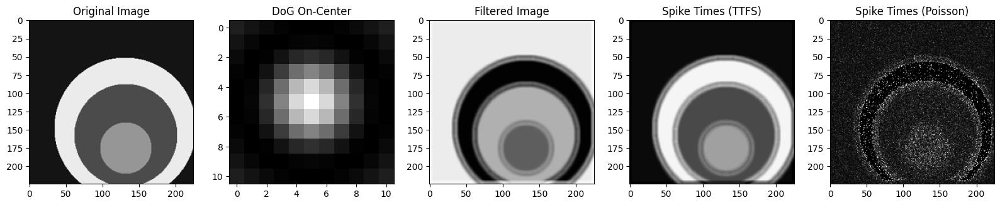

Exception ignored in: <bound method IPythonKernel._clean_thread_parent_frames of <ipykernel.ipkernel.IPythonKernel object at 0x1074696d0>>
Traceback (most recent call last):
  File "/Users/macbook/Library/Python/3.11/lib/python/site-packages/ipykernel/ipkernel.py", line 770, in _clean_thread_parent_frames
    def _clean_thread_parent_frames(

KeyboardInterrupt: 


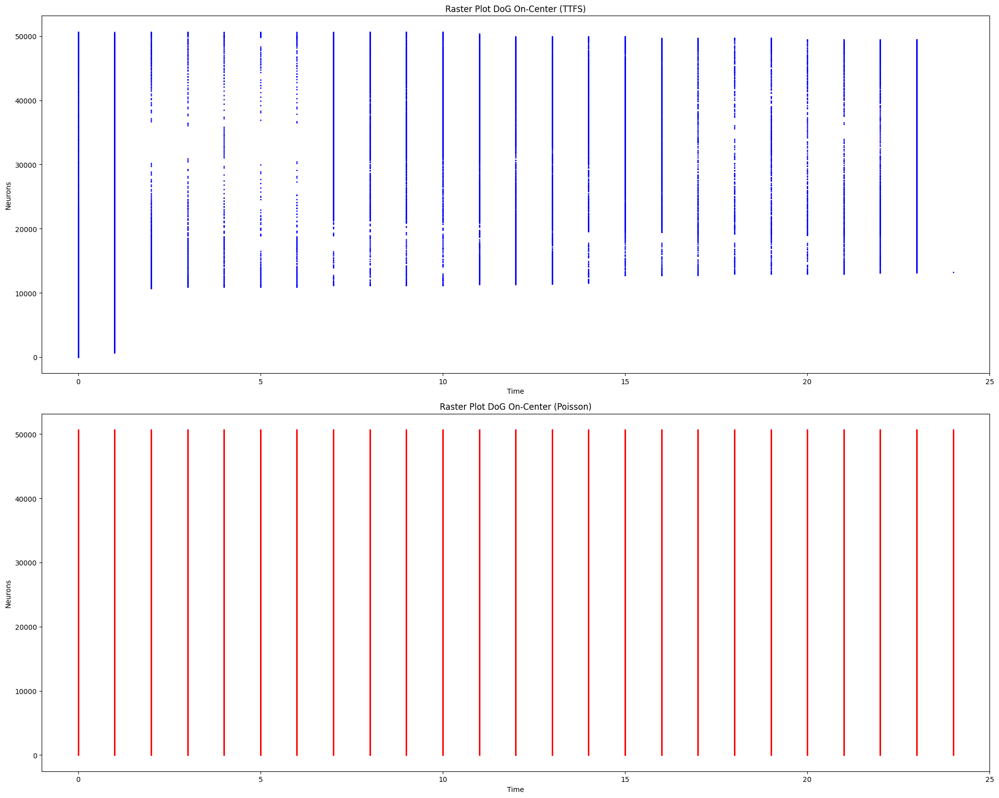

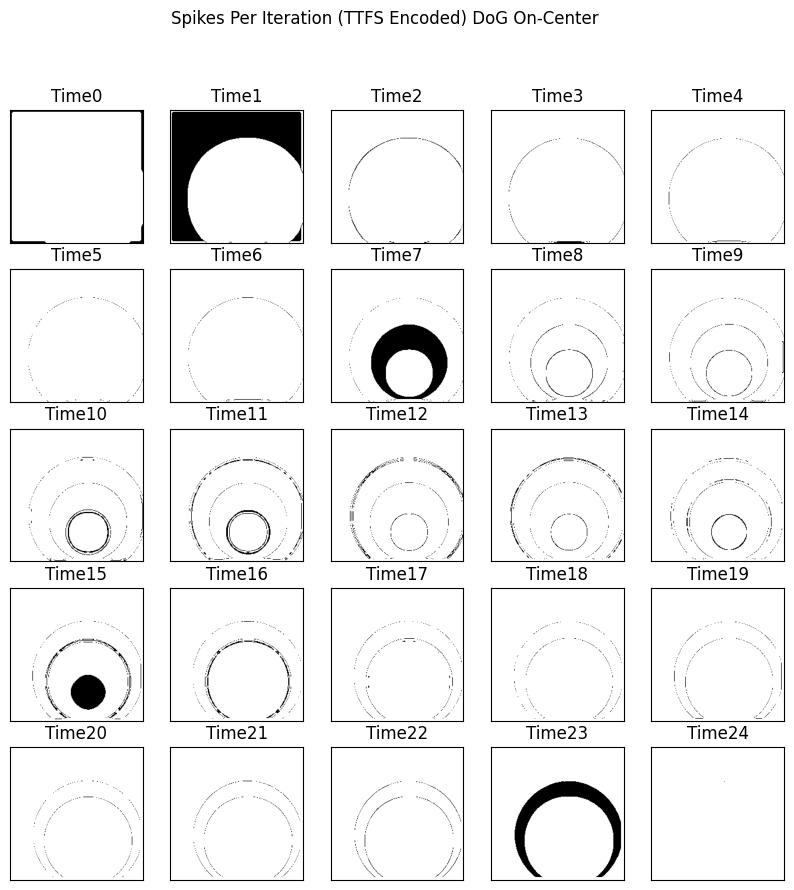

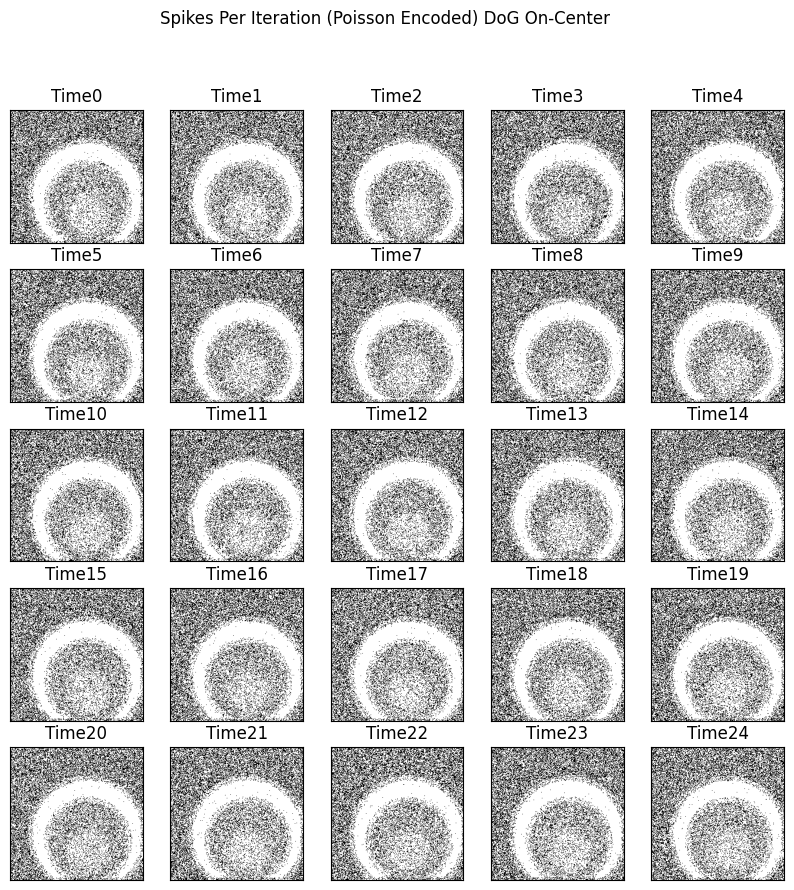

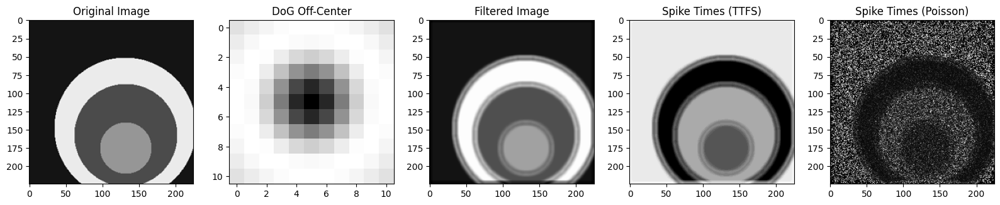

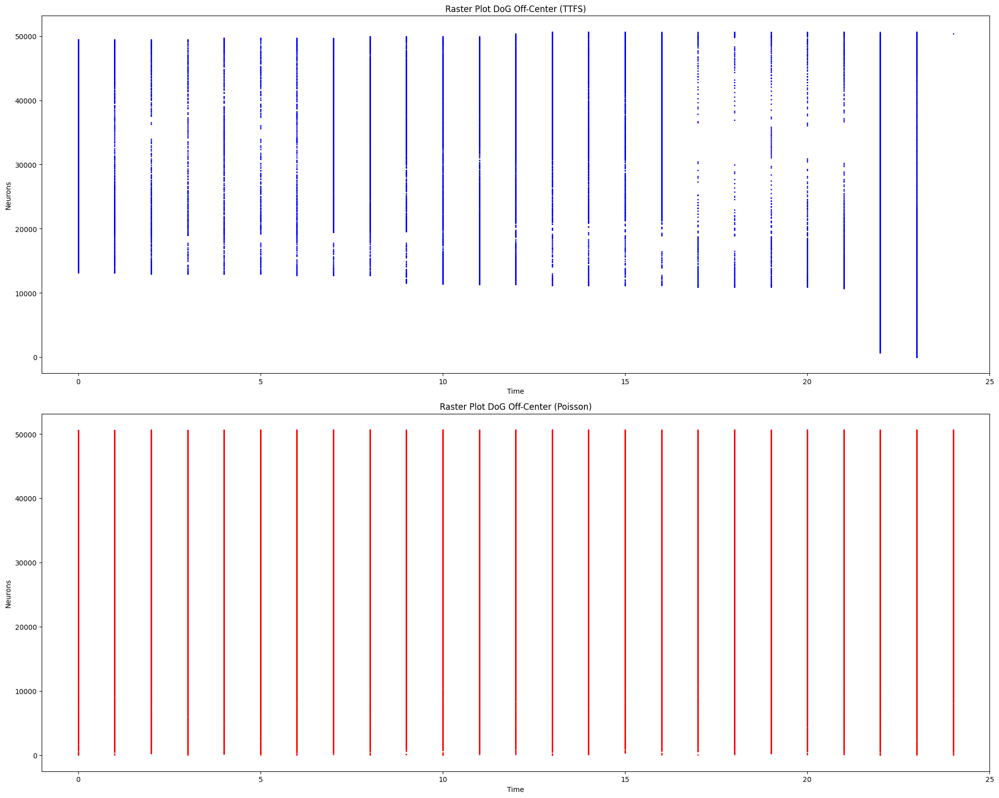

...

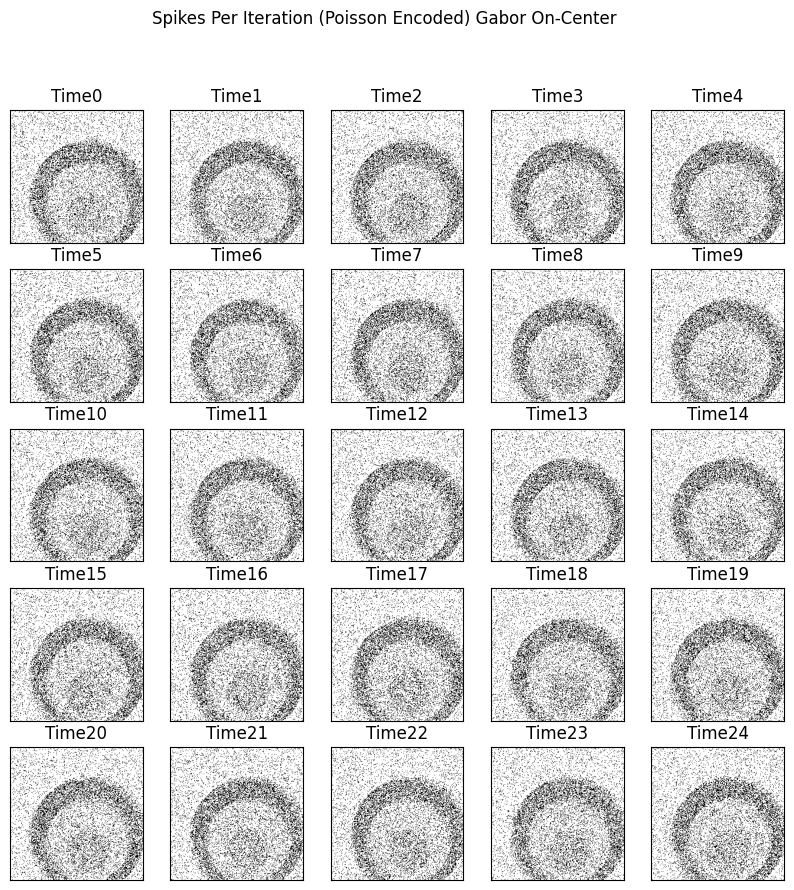

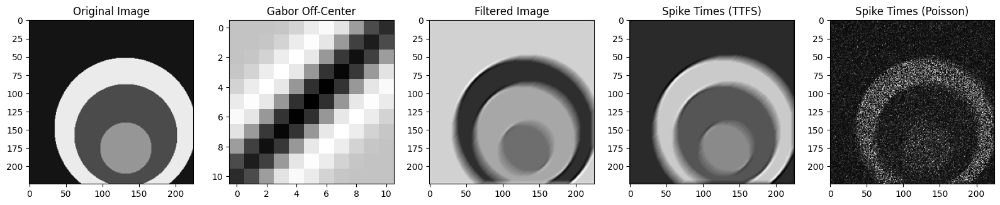

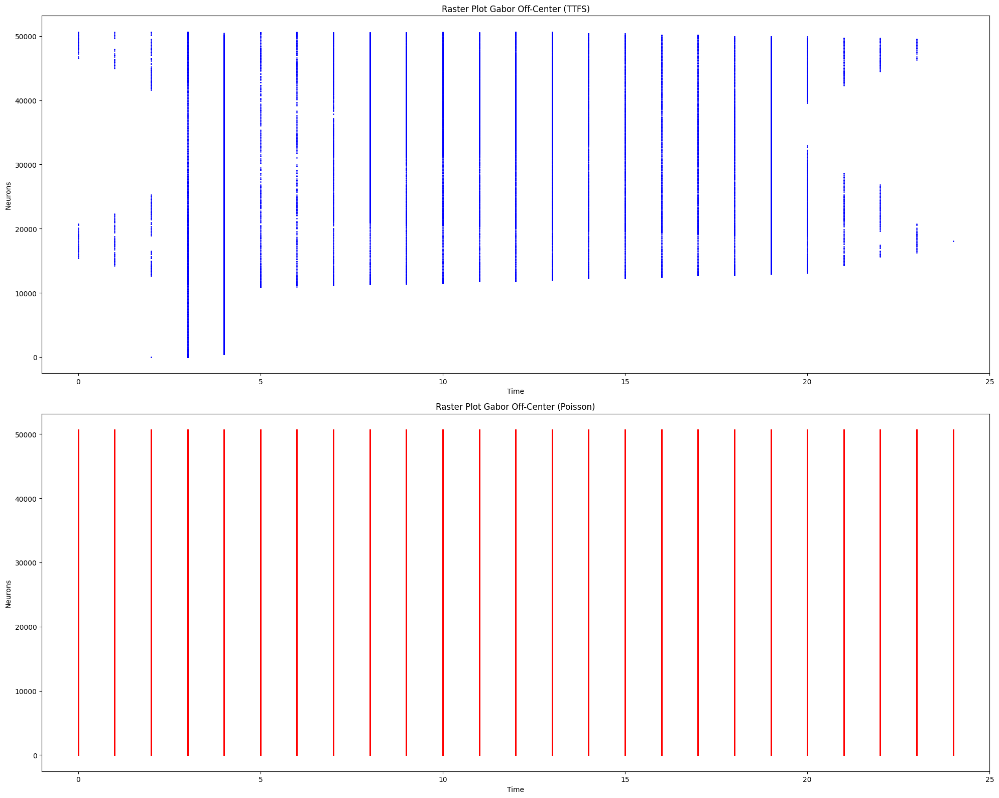

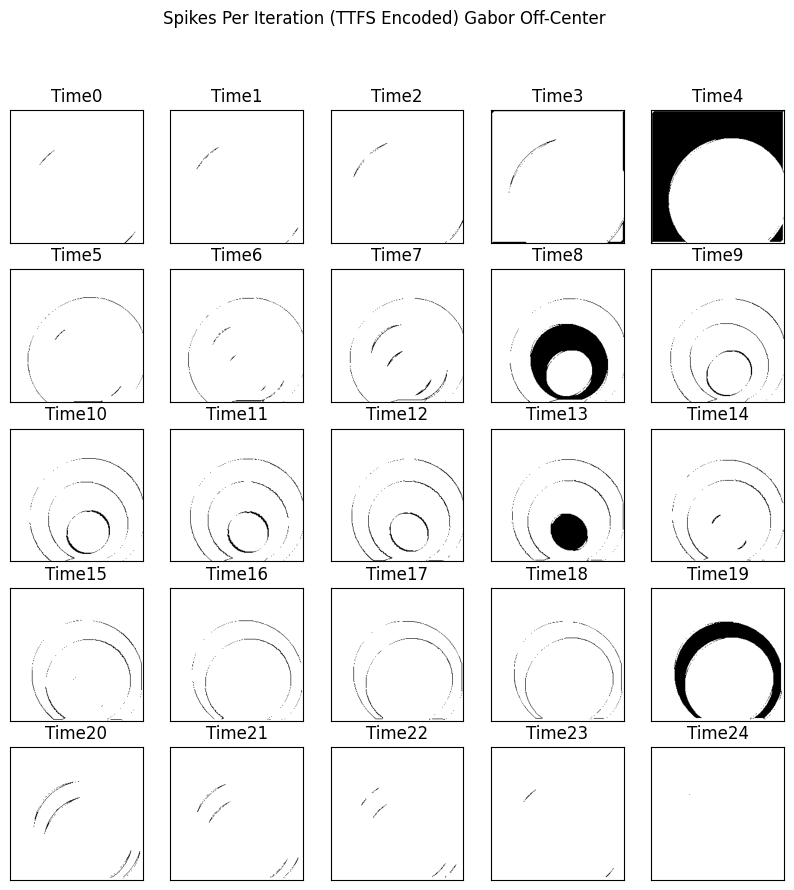

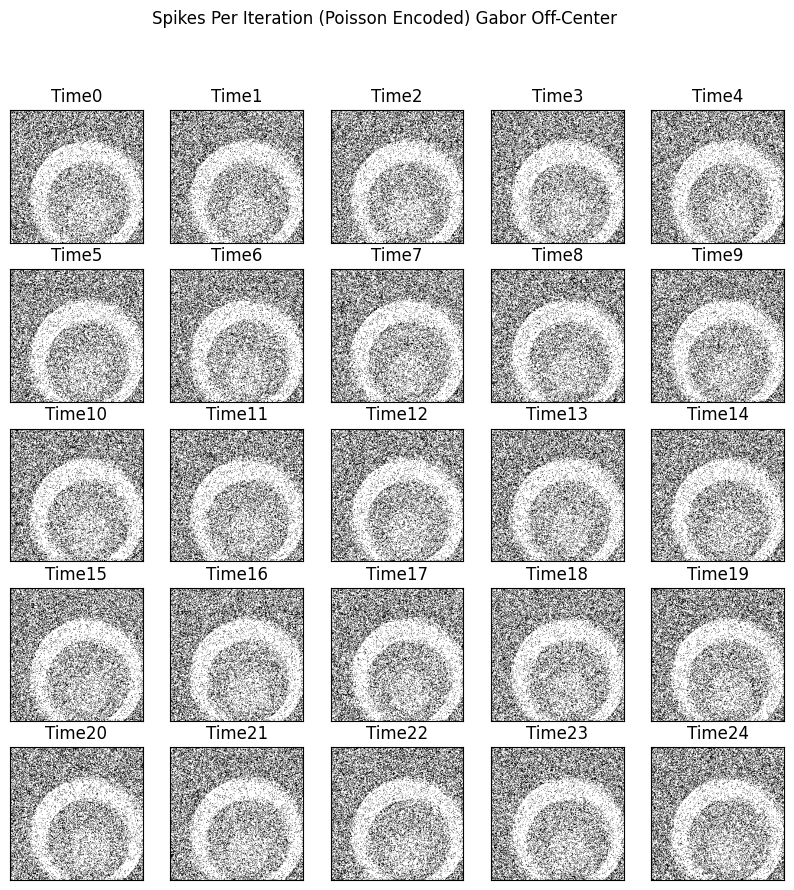

In [864]:
INP_SIZE=112
# (X_train, _), (_, _) = tf.keras.datasets.mnist.load_data()
# x_train = np.array([resize(img, (INP_SIZE, INP_SIZE), anti_aliasing=True) for img in X_train[:500]])
# Xx = torch.tensor(x_train, dtype=torch.float32)
# Xx = Xx / 255.0
# random_index = np.random.randint(0, len(x_train))
# image = Xx[random_index]
# plt.imshow(image, cmap='gray')
TW=25
IMAGES = ['circles.tif']
path = '/Users/macbook/Desktop/CNS/Projects/P05/img'
x_train = np.array([np.array(Image.open(f'{path}/{img}').convert('L').resize((225, 225))) for img in IMAGES])
image_upscaled = x_train / 255.0
Xx = torch.tensor(image_upscaled, dtype=torch.float32)
# x_train = np.array([
#     rgb2gray(resize(img, (112, 112), anti_aliasing=True))
#     for img in X_train[:50]
# ])
# Select a random digit image
random_index = np.random.randint(0, len(x_train))
image = Xx[random_index]

pois = SimplePoisson(time_window=TW, ratio=0.5)
image_tensor = image.unsqueeze(0).unsqueeze(0)

dog_on = DoGFilter(size=11, sigma_1=2, sigma_2=4, dtype=torch.float32).clone().detach().unsqueeze(0).unsqueeze(0)
convFilter_on = Conv2dFilter(filters=dog_on, padding='same')
image_conv_on = convFilter_on(input=image_tensor)
i2l = Intensity2Latency(time_window=TW, min_val=image_conv_on.min().item(), max_val=image_conv_on.max().item())
spikes_on_2d = i2l(image_conv_on).squeeze(2).squeeze(1)
image_conv_on_pois = (image_conv_on - image_conv_on.min()) / (image_conv_on.max()-image_conv_on.min())
spikes_on_2d_pois = pois(image_conv_on_pois).squeeze(2).squeeze(1) 

dog_off = DoGFilter(size=11, sigma_1=4, sigma_2=2, dtype=torch.float32).clone().detach().unsqueeze(0).unsqueeze(0)
convFilter_off = Conv2dFilter(filters=dog_off, padding='same')
image_conv_off = convFilter_off(input=image_tensor)
i2l = Intensity2Latency(time_window=TW, min_val=image_conv_off.min().item(), max_val=image_conv_off.max().item())
spikes_off_2d = i2l(image_conv_off).squeeze(2).squeeze(1)
image_conv_off_pois = (image_conv_off - image_conv_off.min()) / (image_conv_off.max()-image_conv_off.min())
spikes_off_2d_pois = pois(image_conv_off_pois).squeeze(2).squeeze(1)

gabor_on = GaborFilter(size=11, sigma=2, labda=7, theta=np.pi/4, gamma=0.2, dtype=torch.float32).clone().detach().unsqueeze(0).unsqueeze(0)
convFilter_on = Conv2dFilter(filters=gabor_on, padding='same')
image_conv_on_gabor = convFilter_on(input=image_tensor)
i2l = Intensity2Latency(time_window=TW, min_val=image_conv_on_gabor.min().item(), max_val=image_conv_on_gabor.max().item())
spikes_on_2d_gabor = i2l(image_conv_on_gabor).squeeze(2).squeeze(1) 
image_conv_on_gabor_pois = (image_conv_on_gabor - image_conv_on_gabor.min()) / (image_conv_on_gabor.max()-image_conv_on_gabor.min())
spikes_on_2d_gabor_pois = pois(image_conv_on_gabor_pois).squeeze(2).squeeze(1)

gabor_off = GaborFilter(size=11, sigma=2, labda=7, theta=np.pi/4, gamma=0.2,  dtype=torch.float32).clone().detach().unsqueeze(0).unsqueeze(0)
gabor_off = -gabor_on
convFilter_off = Conv2dFilter(filters=gabor_off, padding='same')
image_conv_off_gabor = convFilter_off(input=image_tensor)
i2l = Intensity2Latency(time_window=TW, min_val=image_conv_off_gabor.min().item(), max_val=image_conv_off_gabor.max().item())
spikes_off_2d_gabor = i2l(image_conv_off_gabor).squeeze(2).squeeze(1)
print(image_conv_off_gabor.shape)
print(spikes_off_2d_gabor.shape)
image_conv_off_gabor_pois = (image_conv_off_gabor - image_conv_off_gabor.min()) / (image_conv_off_gabor.max()-image_conv_off_gabor.min())
spikes_off_2d_gabor_pois = pois(image_conv_off_gabor_pois).squeeze(2).squeeze(1)

plotstuff(image_tensor, dog_on, image_conv_on, spikes_on_2d, spikes_on_2d_pois, 'DoG On')
rasterPlot(spikes_on_2d.view(TW, -1), spikes_on_2d_pois.view(TW, -1), TW,  'DoG On')
ttfs_step(spikes_on_2d, TW, '(TTFS Encoded) DoG On')
ttfs_step(spikes_on_2d_pois, TW,  '(Poisson Encoded) DoG On')


plotstuff(image_tensor, dog_off, image_conv_off, spikes_off_2d, spikes_off_2d_pois, 'DoG Off')
rasterPlot(spikes_off_2d.view(TW, -1), spikes_off_2d_pois.view(TW, -1), TW,  'DoG Off')
ttfs_step(spikes_off_2d, TW, '(TTFS Encoded) DoG Off')
ttfs_step(spikes_off_2d_pois, TW,  '(Poisson Encoded) DoG Off')


plotstuff(image_tensor, gabor_on, image_conv_on_gabor,spikes_on_2d_gabor, spikes_on_2d_gabor_pois, 'Gabor On')
rasterPlot(spikes_on_2d_gabor.view(TW, -1),spikes_on_2d_gabor_pois.view(TW, -1), TW,  'Gabor On')
ttfs_step(spikes_on_2d_gabor, TW, '(TTFS Encoded) Gabor On')
ttfs_step(spikes_on_2d_gabor_pois, TW,  '(Poisson Encoded) Gabor On')

plotstuff(image_tensor, gabor_off, image_conv_off_gabor, spikes_off_2d_gabor, spikes_off_2d_gabor_pois, 'Gabor Off')
rasterPlot(spikes_off_2d_gabor.view(TW, -1), spikes_off_2d_gabor_pois.view(TW, -1), TW,  'Gabor Off')
ttfs_step(spikes_off_2d_gabor, TW, '(TTFS Encoded) Gabor Off')
ttfs_step(spikes_off_2d_gabor_pois, TW, '(Poisson Encoded) Gabor Off')


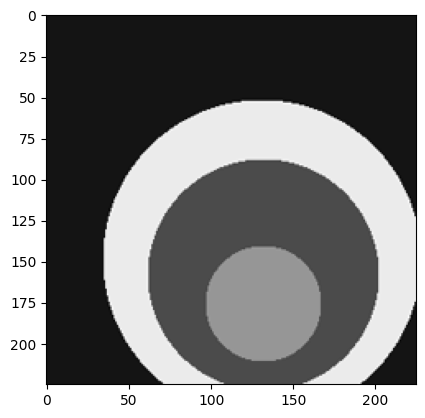

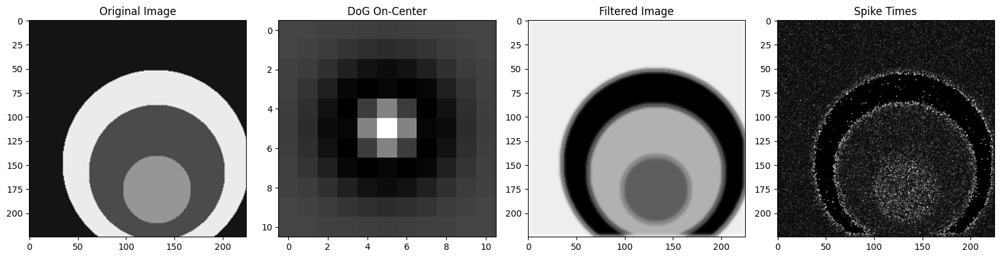

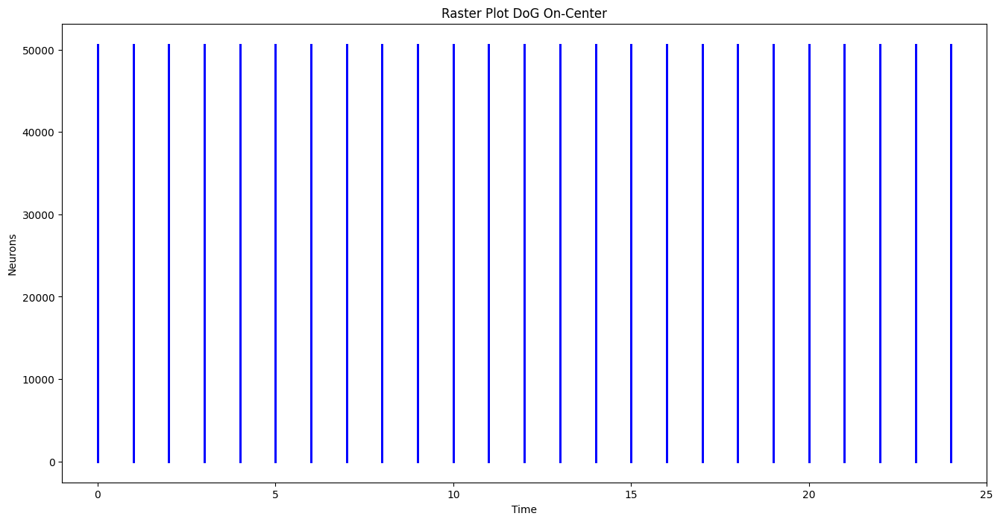

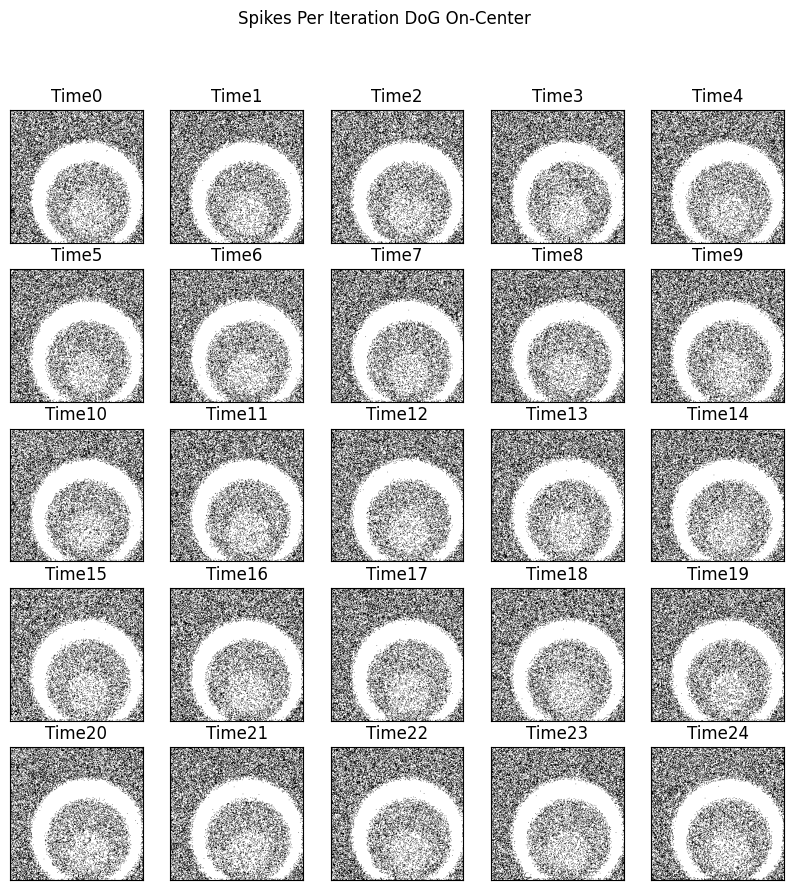

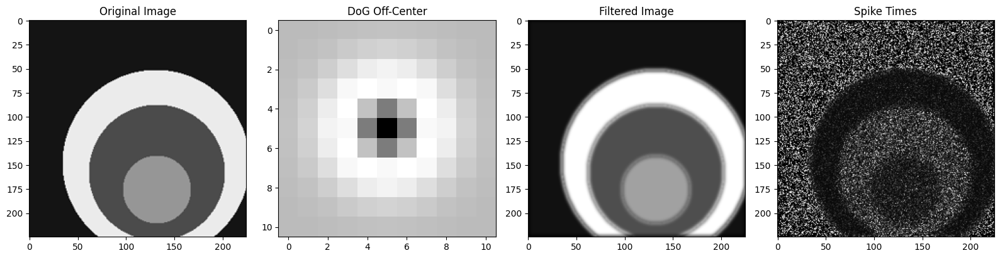

...

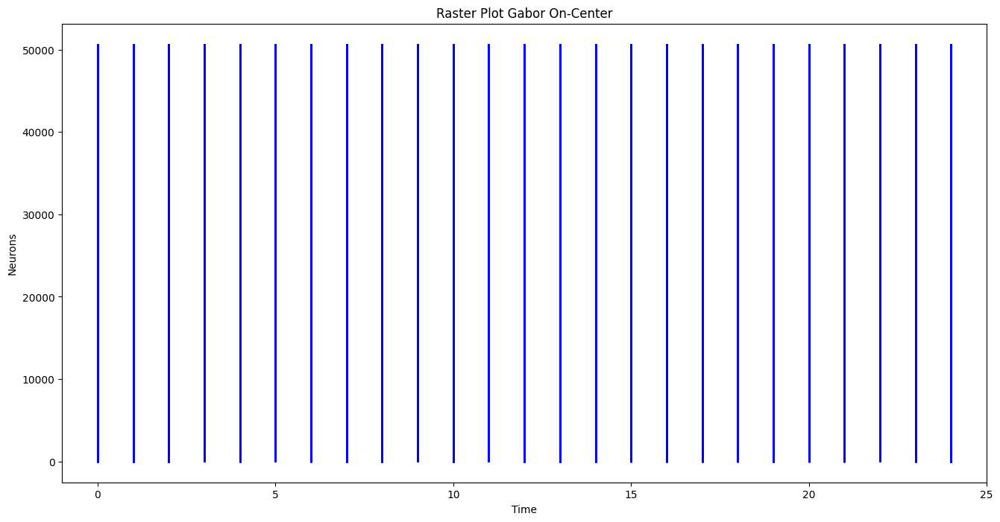

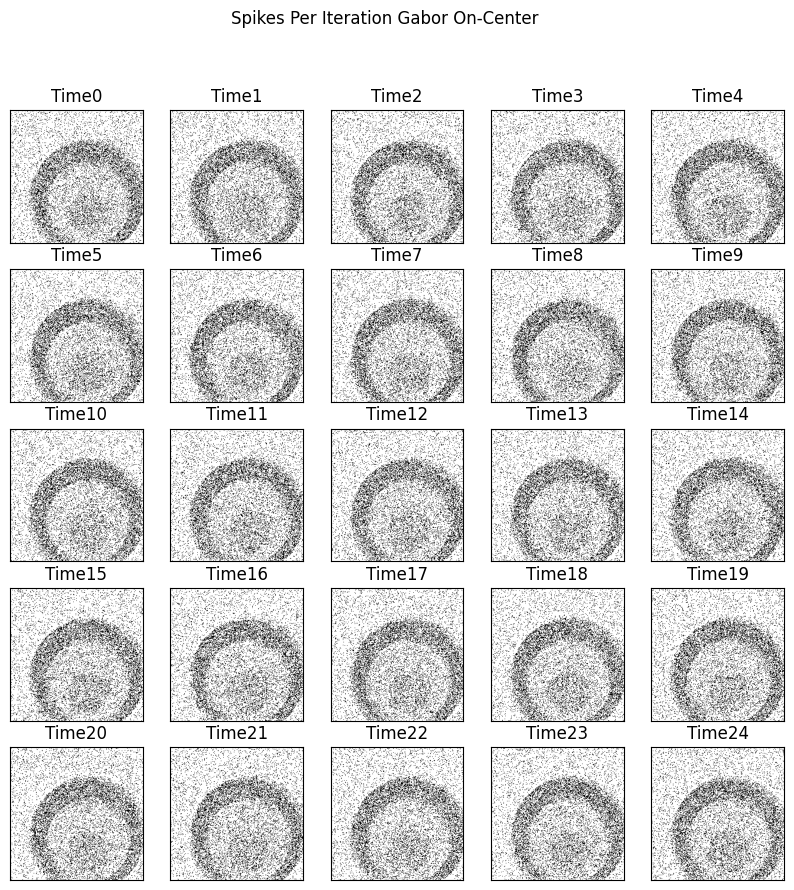

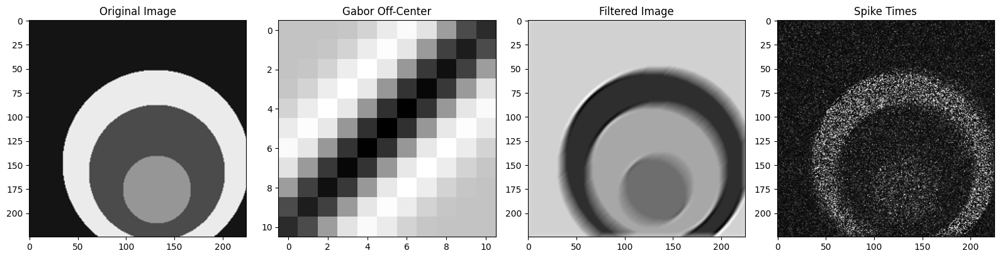

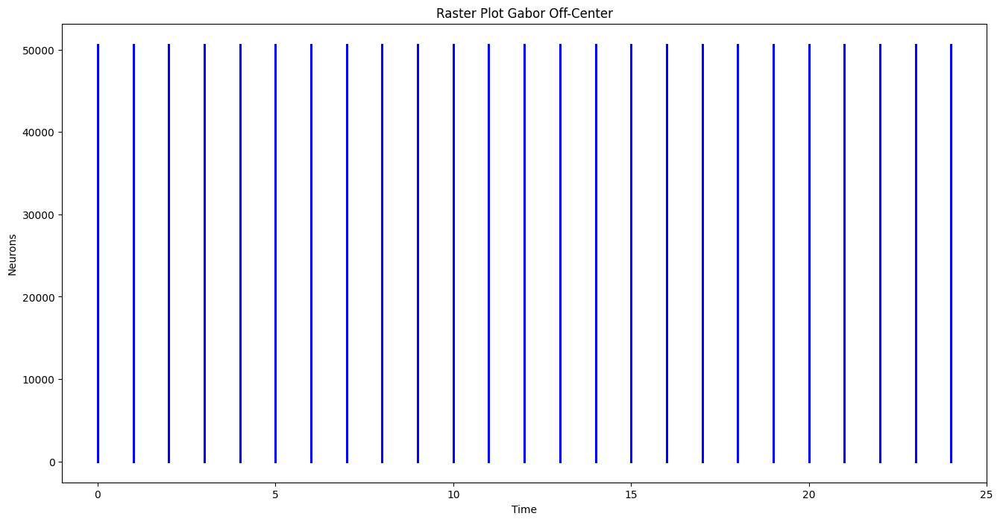

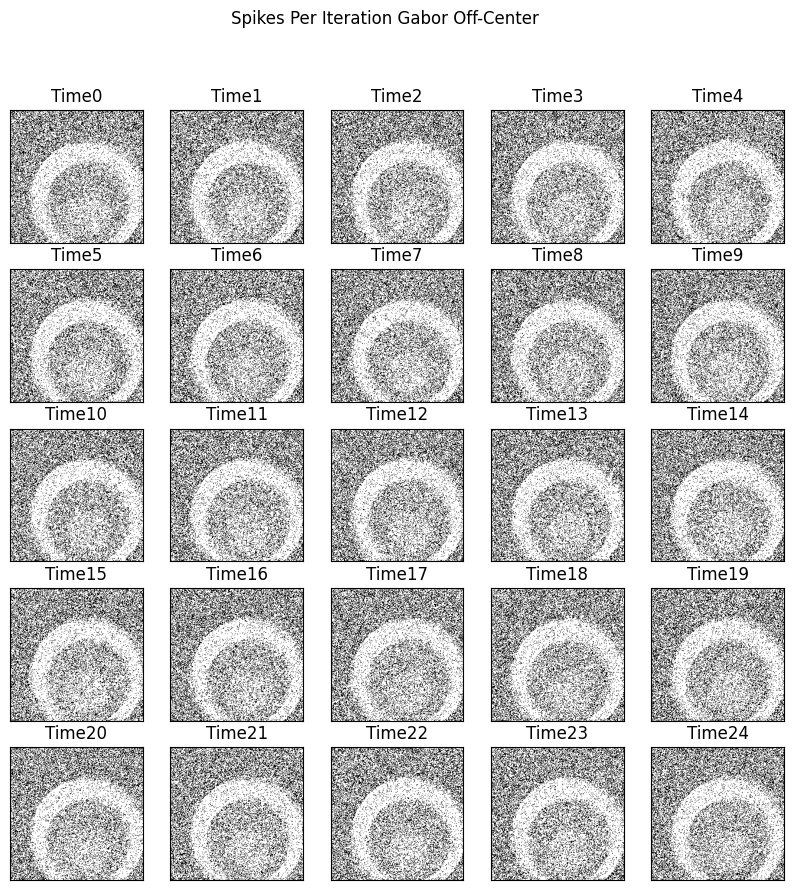

In [ ]:
INP_SIZE=112
# (X_train, _), (_, _) = tf.keras.datasets.mnist.load_data()
# x_train = np.array([resize(img, (INP_SIZE, INP_SIZE), anti_aliasing=True) for img in X_train[:500]])
# Xx = torch.tensor(x_train, dtype=torch.float32)
# Xx = Xx / 255.0
# random_index = np.random.randint(0, len(x_train))
# image = Xx[random_index]
# plt.imshow(image, cmap='gray')
TW=25
IMAGES = ['circles.tif']
path = '/Users/macbook/Desktop/CNS/Projects/P05/img'
x_train = np.array([np.array(Image.open(f'{path}/{img}').convert('L').resize((225, 225))) for img in IMAGES])
image_upscaled = x_train / 255.0
Xx = torch.tensor(image_upscaled, dtype=torch.float32)
# x_train = np.array([
#     rgb2gray(resize(img, (112, 112), anti_aliasing=True))
#     for img in X_train[:50]
# ])
# Select a random digit image
random_index = np.random.randint(0, len(x_train))
image = Xx[random_index]
plt.imshow(image, cmap='gray')

pois = SimplePoisson(time_window=TW, ratio=0.5)
image_tensor = image.unsqueeze(0).unsqueeze(0)

dog_on = DoGFilter(size=11, sigma_1=1, sigma_2=2, dtype=torch.float32).clone().detach().unsqueeze(0).unsqueeze(0)
convFilter_on = Conv2dFilter(filters=dog_on, padding='same')
image_conv_on = convFilter_on(input=image_tensor)

image_conv_on = (image_conv_on - image_conv_on.min()) / (image_conv_on.max()-image_conv_on.min())
spikes_on_2d = pois(image_conv_on).squeeze(2).squeeze(1) 

dog_off = DoGFilter(size=11, sigma_1=2, sigma_2=1, dtype=torch.float32).clone().detach().unsqueeze(0).unsqueeze(0)
convFilter_off = Conv2dFilter(filters=dog_off, padding='same')
image_conv_off = convFilter_off(input=image_tensor)
image_conv_off = (image_conv_off - image_conv_off.min()) / (image_conv_off.max()-image_conv_off.min())
spikes_off_2d = pois(image_conv_off).squeeze(2).squeeze(1)

gabor_on = GaborFilter(size=11, sigma=2, labda=7, theta=np.pi/4, gamma=0.2, dtype=torch.float32).clone().detach().unsqueeze(0).unsqueeze(0)
convFilter_on = Conv2dFilter(filters=gabor_on, padding='same')
image_conv_on_gabor = convFilter_on(input=image_tensor)
image_conv_on_gabor = (image_conv_on_gabor - image_conv_on_gabor.min()) / (image_conv_on_gabor.max()-image_conv_on_gabor.min())
spikes_on_2d_gabor = pois(image_conv_on_gabor).squeeze(2).squeeze(1) 

gabor_off = GaborFilter(size=11, sigma=2, labda=7, theta=np.pi/4, gamma=0.2,  dtype=torch.float32).clone().detach().unsqueeze(0).unsqueeze(0)
gabor_off = -gabor_on
convFilter_off = Conv2dFilter(filters=gabor_off, padding='same')
image_conv_off_gabor = convFilter_off(input=image_tensor)
image_conv_off_gabor = (image_conv_off_gabor - image_conv_off_gabor.min()) / (image_conv_off_gabor.max()-image_conv_off_gabor.min())
spikes_off_2d_gabor = pois(image_conv_off_gabor).squeeze(2).squeeze(1)


plotstuff(image_tensor, dog_on, image_conv_on, spikes_on_2d, 'DoG On')
rasterPlot(spikes_on_2d.view(TW, -1), TW,  'DoG On')
ttfs_step(spikes_on_2d, TW, 'DoG On')

plotstuff(image_tensor, dog_off, image_conv_off, spikes_off_2d, 'DoG Off')
rasterPlot(spikes_off_2d.view(TW, -1), TW,  'DoG Off')
ttfs_step(spikes_off_2d, TW, 'DoG Off')

plotstuff(image_tensor, gabor_on, image_conv_on_gabor,spikes_on_2d_gabor, 'Gabor On')
rasterPlot(spikes_on_2d_gabor.view(TW, -1), TW,  'Gabor On')
ttfs_step(spikes_on_2d_gabor, TW,  'Gabor On')

plotstuff(image_tensor, gabor_off, image_conv_off_gabor, spikes_off_2d_gabor, 'Gabor Off')
rasterPlot(spikes_off_2d_gabor.view(TW, -1), TW,  'Gabor Off')
ttfs_step(spikes_off_2d_gabor, TW, 'Gabor Off')

TypeError: scatter() missing 1 required positional argument: 'y'

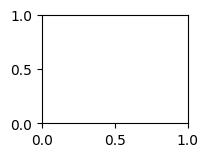

In [ ]:
# for i, it in enumerate([0, 100, 200, 300, 400, 500, 600, 700, 1999]):
#     nn = 330+i+1
#     plt.subplot(nn)
#     plt.imshow(spikes_on_2d_gabor[it, :, :], cmap='gray')
#     plt.title(f'Convolved Image')


## poisson

In [ ]:
# Select a random digit image
random_index = np.random.randint(0, len(x_train))
image = x_train[random_index]

# Upscale the image to 254x254
scale_factor = 254 / 28  # Approximately 9.07
image_upscaled = zoom(image, scale_factor, order=3)

# Normalize the image
image = image_upscaled / 255.0

# Create and apply DoG filters
dog_on_center, dog_off_center = dog_filter(31, 3, 6)

filtered_dog_on = apply_and_show_filter(image, dog_on_center, 'DoG On-Center')
filtered_dog_off = apply_and_show_filter(image, dog_off_center, 'DoG Off-Center')

# Create and apply Gabor filters
gabor_on_center = gabor_filter(31, 3, np.pi/4, 10, 0.5, 0)
gabor_off_center = -gabor_on_center

filtered_gabor_on = apply_and_show_filter(image, gabor_on_center, 'Gabor On-Center')
filtered_gabor_off = apply_and_show_filter(image, gabor_off_center, 'Gabor Off-Center')


In [ ]:

def poisson_encoding(image, time_window, max_rate=1):
    normalized_image = (image - image.min()) / (image.max() - image.min())
    rates = normalized_image * max_rate  # Scale to max_rate
    
    spikes = np.random.poisson(time_window, rates[:, :, np.newaxis] * time_window, (image.shape[0], image.shape[1]))
    print(np.shape(spikes))
    spike_times = np.where(spikes)[2]
    print(np.shape(spike_times))
    spike_counts = np.sum(spikes, axis=2)
    
    return spike_times, spike_counts, spikes


In [ ]:


# Select a random digit image
random_index = np.random.randint(0, len(x_train))
image = x_train[random_index]

# Upscale the image to 254x254
scale_factor = 254 / 28  # Approximately 9.07
image_upscaled = zoom(image, scale_factor, order=3)

# Normalize the image
image = image_upscaled / 255.0

# Create and apply DoG filters
dog_on_center, dog_off_center = dog_filter(31, 3, 6)

filtered_dog_on = apply_and_show_filter(image, dog_on_center, 'DoG On-Center')
filtered_dog_off = apply_and_show_filter(image, dog_off_center, 'DoG Off-Center')

# Create and apply Gabor filters
gabor_on_center = gabor_filter(31, 3, np.pi/4, 10, 0.5, 0)
gabor_off_center = -gabor_on_center

filtered_gabor_on = apply_and_show_filter(image, gabor_on_center, 'Gabor On-Center')
filtered_gabor_off = apply_and_show_filter(image, gabor_off_center, 'Gabor Off-Center')


In [ ]:
# Apply Poisson encoding
time_window = 100
pois = Poisson(time_window, 1)

# _, spike_counts_dog_on, spikes_dog_on = poisson_encoding(image_conv_on, time_window)
# _, spike_counts_dog_off, spikes_dog_off = poisson_encoding(image_conv_off, time_window)
# _, spike_counts_gabor_on, spikes_gabor_on = poisson_encoding(image_conv_on_gabor, time_window)
# _, spike_counts_gabor_off, spikes_gabor_off = poisson_encoding(image_conv_off_gabor, time_window)

# Display Poisson encoding results (spike counts)
plt.figure(figsize=(16, 4))
plt.subplot(141), plt.imshow(spike_counts_dog_on, cmap='viridis'), plt.title('DoG On-Center')
plt.subplot(142), plt.imshow(spike_counts_dog_off, cmap='viridis'), plt.title('DoG Off-Center')
plt.subplot(143), plt.imshow(spike_counts_gabor_on, cmap='viridis'), plt.title('Gabor On-Center')
plt.subplot(144), plt.imshow(spike_counts_gabor_off, cmap='viridis'), plt.title('Gabor Off-Center')
plt.colorbar()
plt.show()

# Create raster plots
raster_plot(spikes_dog_on.reshape(-1, time_window), 'DoG On-Center Raster Plot')
raster_plot(spikes_dog_off.reshape(-1, time_window), 'DoG Off-Center Raster Plot')
raster_plot(spikes_gabor_on.reshape(-1, time_window), 'Gabor On-Center Raster Plot')
raster_plot(spikes_gabor_off.reshape(-1, time_window), 'Gabor Off-Center Raster Plot')


TypeError: poisson() takes at most 2 positional arguments (3 given)

(225, 225, 3)


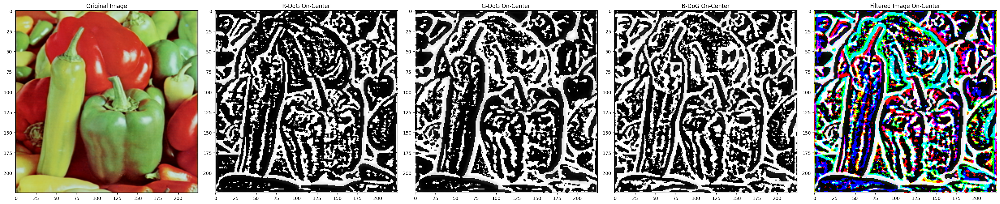

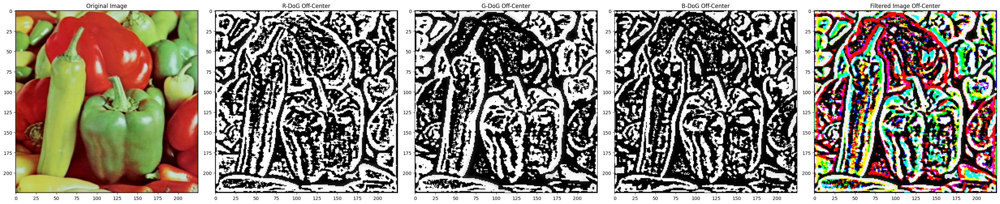

In [ ]:
import numpy as np
from scipy import ndimage
import matplotlib.pyplot as plt

def dog_filter_color(image, sigma1, sigma2):
    """
    Apply Difference of Gaussians filter to a color image.
    
    Args:
    image (numpy.ndarray): Input color image (H x W x 3)
    sigma1 (float): Standard deviation for the first Gaussian
    sigma2 (float): Standard deviation for the second Gaussian
    
    Returns:
    numpy.ndarray: Filtered color image
    """
    # Separate color channels
    r, g, b = image[:,:,0], image[:,:,1], image[:,:,2]
    
    # Apply DoG to each channel
    r_dog1 = dog_filter_channel(r, sigma1, sigma2)
    g_dog1 = dog_filter_channel(g, sigma1, sigma2)
    b_dog1 = dog_filter_channel(b, sigma1, sigma2)

    r_dog2 = -r_dog1
    g_dog2 = -g_dog1
    b_dog2 = -b_dog1
    
    # Recombine channels
    dog_image1 = np.stack([r_dog1, g_dog1, b_dog1], axis=2)
    dog_image2 = np.stack([r_dog2, g_dog2, b_dog2], axis=2)
    
    # Normalize to [0, 1] range
    dog_image1 = (dog_image1 - dog_image1.min()) / (dog_image1.max() - dog_image1.min())
    dog_image2 = (dog_image2 - dog_image2.min()) / (dog_image2.max() - dog_image2.min())
    
    return dog_image1, r_dog1, g_dog1, b_dog1, dog_image2, r_dog2, g_dog2, b_dog2

def dog_filter_channel(channel, sigma1, sigma2):
    """
    Apply Difference of Gaussians filter to a single channel.
    
    Args:
    channel (numpy.ndarray): Input image channel
    sigma1 (float): Standard deviation for the first Gaussian
    sigma2 (float): Standard deviation for the second Gaussian
    
    Returns:
    numpy.ndarray: Filtered channel
    """
    # Apply Gaussian filters
    g1 = ndimage.gaussian_filter(channel, sigma1)
    g2 = ndimage.gaussian_filter(channel, sigma2)
    
    # Compute difference
    dog = g1 - g2
    return dog

# Example usage
IMAGES = ['peppers3.tif']
path = '/Users/macbook/Desktop/CNS/Projects/P05/imt_color'
x_train = np.array([np.array(Image.open(f'{path}/{img}').resize((225, 225))) for img in IMAGES])
random_index = np.random.randint(0, len(x_train))
image = x_train[random_index]
print(image.shape)
# Apply DoG filter
sigma1, sigma2 = 1.0, 2.0
dog_image1, r_dog1, g_dog1, b_dog1, dog_image2, r_dog2, g_dog2, b_dog2 = dog_filter_color(image, sigma1, sigma2)

# Display results
plt.figure(figsize=(30, 6))
plt.subplot(151), plt.imshow(image), plt.title(f'Original Image')
plt.subplot(152), plt.imshow(r_dog1, cmap='gray'), plt.title(f'R-DoG On-Center')
plt.subplot(153), plt.imshow(g_dog1, cmap='gray'), plt.title(f'G-DoG On-Center')
plt.subplot(154), plt.imshow(b_dog1, cmap='gray'), plt.title(f'B-DoG On-Center')
plt.subplot(155), plt.imshow(dog_image1), plt.title(f'Filtered Image On-Center')
plt.tight_layout()
plt.show()

plt.figure(figsize=(30, 6))
plt.subplot(151), plt.imshow(image), plt.title(f'Original Image')
plt.subplot(152), plt.imshow(r_dog2, cmap='gray'), plt.title(f'R-DoG Off-Center')
plt.subplot(153), plt.imshow(g_dog2, cmap='gray'), plt.title(f'G-DoG Off-Center')
plt.subplot(154), plt.imshow(b_dog2, cmap='gray'), plt.title(f'B-DoG Off-Center')
plt.subplot(155), plt.imshow(dog_image2), plt.title(f'Filtered Image Off-Center')
plt.tight_layout()
plt.show()
